Title: Breast Cancer Wisconsin (Diagnostic) — End-to-End Analytics & Modeling
Description: A comprehensive 30-section data analytics workflow for the Kaggle Breast Cancer Wisconsin (Diagnostic) dataset (569 samples; numeric features + diagnosis). Covers import, cleaning, exhaustive EDA, feature engineering & selection, modeling, hyperparameter tuning, interpretability (SHAP), clustering, dashboards, deployment artifacts, and an executive summary.
Dataset: https://www.kaggle.com/datasets/uciml/breast-cancer-wisconsin-data

Author: Mandeep Kaur
Date: 2025-11-13

Execution Notes:
- Assumes local CSV available and loaded via pd.read_csv(). Default path: c:\\Users\\Shank\\Desktop\\Mandeep\\data.csv; falls back to ./data.csv.
- Heavy steps: SHAP, t-SNE, UMAP, Plotly image export. Toggle flags at top to skip on low-RAM machines.
- Figures saved to figures/ at DPI=300; reports and artifacts saved to reports/ and artifacts/ respectively.

Clinical Disclaimer:
This is exploratory analysis — clinical decisions require external validation and expert review.

In [1]:
import os
import io
import json
import time
import warnings
from datetime import datetime

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display, HTML

from scipy import stats
from statsmodels.stats.weightstats import ttest_ind
from statsmodels.stats.power import tt_ind_solve_power

from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV, StratifiedKFold, cross_val_score, learning_curve, validation_curve
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import (classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve,
                             average_precision_score, roc_auc_score, brier_score_loss, log_loss)
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.inspection import permutation_importance
from sklearn.calibration import CalibratedClassifierCV, calibration_curve
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.feature_selection import SelectKBest, f_classif, RFE
from sklearn.metrics import silhouette_score, adjusted_rand_score

try:
    import xgboost as xgb  # optional
    XGB_AVAILABLE = True
except Exception:
    XGB_AVAILABLE = False

try:
    import shap  # interpretability
    SHAP_AVAILABLE = True
except Exception:
    SHAP_AVAILABLE = False

try:
    import missingno as msno
    MSNO_AVAILABLE = True
except Exception:
    MSNO_AVAILABLE = False

try:
    import plotly.express as px
    import plotly.graph_objects as go
    from plotly.subplots import make_subplots
    PLOTLY_AVAILABLE = True
except Exception:
    PLOTLY_AVAILABLE = False

try:
    import umap  # optional embedding
    UMAP_AVAILABLE = True
except Exception:
    UMAP_AVAILABLE = False

try:
    import networkx as nx
    NX_AVAILABLE = True
except Exception:
    NX_AVAILABLE = False

import joblib

warnings.filterwarnings("ignore")

# Reproducibility & style
SEED = 1337
np.random.seed(SEED)
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['font.size'] = 10
mpl.rcParams['figure.figsize'] = (8, 5)
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("Set2")

# Runtime flags for heavy steps
RUN_SHAP = True
RUN_TSNE = True
RUN_UMAP = True
WRITE_PLOTLY_IMAGE = False  # requires kaleido/orca

# Paths
CSV_PATH_PRIMARY = r"c:\\Users\\Shank\\Desktop\\Mandeep\\data.csv"
CSV_PATH_FALLBACK = r"./data.csv"
DIRS = {
    "data": "data",
    "figures": "figures",
    "artifacts": "artifacts",
    "reports": "reports",
    "notebook": "notebook"
}


def ensure_dirs():
    for d in DIRS.values():
        os.makedirs(d, exist_ok=True)


def save_fig(fig, name, tight=True):
    fp = os.path.join(DIRS["figures"], name)
    if tight:
        try:
            fig.tight_layout()
        except Exception:
            pass
    fig.savefig(fp, dpi=300)
    try:
        display(fig)
    except Exception:
        pass
    plt.close(fig)
    return fp


def fmt_title(s):
    return s.replace(" ", "_").lower()


def styled_to_html(df, name):
    html_path = os.path.join(DIRS["reports"], name)
    html_str = df.style.background_gradient(cmap="Blues").set_table_attributes('class="table"').to_html()
    with open(html_path, "w", encoding="utf-8") as f:
        f.write(html_str)
    try:
        display(HTML(html_str))
    except Exception:
        pass
    return html_path


def summarize_model_performance(model_name, y_true, y_prob, y_pred):
    try:
        roc = roc_auc_score(y_true, y_prob)
    except Exception:
        roc = np.nan
    return {
        "model": model_name,
        "accuracy": accuracy_score(y_true, y_pred),
        "precision": precision_score(y_true, y_pred),
        "recall": recall_score(y_true, y_pred),
        "f1": f1_score(y_true, y_pred),
        "auc": roc
    }


def plot_compare_scalers(series, name_prefix):
    fig, axes = plt.subplots(1, 4, figsize=(14, 3))
    axes[0].hist(series, bins=30, color="#66c2a5", alpha=0.8)
    axes[0].set_title("Original")
    for ax_i, scaler, title in zip(axes[1:], [StandardScaler(), MinMaxScaler(), RobustScaler()], ["Standard", "MinMax", "Robust"]):
        x = series.values.reshape(-1, 1)
        xs = scaler.fit_transform(x).ravel()
        ax_i.hist(xs, bins=30, color="#66c2a5", alpha=0.8)
        ax_i.set_title(title)
    fig.suptitle(f"Scaling Comparison — {series.name}")
    return save_fig(fig, f"scaling_compare_{fmt_title(name_prefix)}_{fmt_title(series.name)}.png")


def effect_size_cohen_d(x, y):
    nx = len(x)
    ny = len(y)
    vx = np.var(x, ddof=1)
    vy = np.var(y, ddof=1)
    s = np.sqrt(((nx - 1) * vx + (ny - 1) * vy) / (nx + ny - 2))
    return (np.mean(x) - np.mean(y)) / s if s > 0 else np.nan


def safe_install_msg(lib_name, instructions):
    print(f"Optional library '{lib_name}' not available. {instructions}")


ensure_dirs()

Section 1 — Data Import
Learning Objective: Load the dataset reproducibly and establish consistent configuration.
Clinician Prompt: Confirm dataset reflects your population; note sampling biases.

In [2]:
CSV_PATH = CSV_PATH_PRIMARY if os.path.exists(CSV_PATH_PRIMARY) else CSV_PATH_FALLBACK
print(f"Loading CSV from: {CSV_PATH}")
df_raw = pd.read_csv(CSV_PATH)
df = df_raw.copy()

head_html = styled_to_html(df.head(10), "head10.html")
tail_html = styled_to_html(df.tail(10), "tail10.html")
print(f"Saved styled head/tail to: {head_html}, {tail_html}")

Loading CSV from: c:\\Users\\Shank\\Desktop\\Mandeep\\data.csv


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.990000,10.380000,122.800000,1001.000000,0.118400,0.277600,0.300100,0.147100,0.241900,0.078710,1.095000,0.905300,8.589000,153.400000,0.006399,0.049040,0.053730,0.015870,0.030030,0.006193,25.380000,17.330000,184.600000,2019.000000,0.162200,0.665600,0.711900,0.265400,0.460100,0.118900,nan
1,842517,M,20.570000,17.770000,132.900000,1326.000000,0.084740,0.078640,0.086900,0.070170,0.181200,0.056670,0.543500,0.733900,3.398000,74.080000,0.005225,0.013080,0.018600,0.013400,0.013890,0.003532,24.990000,23.410000,158.800000,1956.000000,0.123800,0.186600,0.241600,0.186000,0.275000,0.089020,nan
2,84300903,M,19.690000,21.250000,130.000000,1203.000000,0.109600,0.159900,0.197400,0.127900,0.206900,0.059990,0.745600,0.786900,4.585000,94.030000,0.006150,0.040060,0.038320,0.020580,0.022500,0.004571,23.570000,25.530000,152.500000,1709.000000,0.144400,0.424500,0.450400,0.243000,0.361300,0.087580,nan
3,84348301,M,11.420000,20.380000,77.580000,386.100000,0.142500,0.283900,0.241400,0.105200,0.259700,0.097440,0.495600,1.156000,3.445000,27.230000,0.009110,0.074580,0.056610,0.018670,0.059630,0.009208,14.910000,26.500000,98.870000,567.700000,0.209800,0.866300,0.686900,0.257500,0.663800,0.173000,nan
4,84358402,M,20.290000,14.340000,135.100000,1297.000000,0.100300,0.132800,0.198000,0.104300,0.180900,0.058830,0.757200,0.781300,5.438000,94.440000,0.011490,0.024610,0.056880,0.018850,0.017560,0.005115,22.540000,16.670000,152.200000,1575.000000,0.137400,0.205000,0.400000,0.162500,0.236400,0.076780,nan
5,843786,M,12.450000,15.700000,82.570000,477.100000,0.127800,0.170000,0.157800,0.080890,0.208700,0.076130,0.334500,0.890200,2.217000,27.190000,0.007510,0.033450,0.036720,0.011370,0.021650,0.005082,15.470000,23.750000,103.400000,741.600000,0.179100,0.524900,0.535500,0.174100,0.398500,0.124400,nan
6,844359,M,18.250000,19.980000,119.600000,1040.000000,0.094630,0.109000,0.112700,0.074000,0.179400,0.057420,0.446700,0.773200,3.180000,53.910000,0.004314,0.013820,0.022540,0.010390,0.013690,0.002179,22.880000,27.660000,153.200000,1606.000000,0.144200,0.257600,0.378400,0.193200,0.306300,0.083680,nan
7,84458202,M,13.710000,20.830000,90.200000,577.900000,0.118900,0.164500,0.093660,0.059850,0.219600,0.074510,0.583500,1.377000,3.856000,50.960000,0.008805,0.030290,0.024880,0.014480,0.014860,0.005412,17.060000,28.140000,110.600000,897.000000,0.165400,0.368200,0.267800,0.155600,0.319600,0.115100,nan
8,844981,M,13.000000,21.820000,87.500000,519.800000,0.127300,0.193200,0.185900,0.093530,0.235000,0.073890,0.306300,1.002000,2.406000,24.320000,0.005731,0.035020,0.035530,0.012260,0.021430,0.003749,15.490000,30.730000,106.200000,739.300000,0.170300,0.540100,0.539000,0.206000,0.437800,0.107200,nan
9,84501001,M,12.460000,24.040000,83.970000,475.900000,0.118600,0.239600,0.227300,0.085430,0.203000,0.082430,0.297600,1.599000,2.039000,23.940000,0.007149,0.072170,0.077430,0.014320,0.017890,0.010080,15.090000,40.680000,97.650000,711.400000,0.185300,1.058000,1.105000,0.221000,0.436600,0.207500,nan


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
559,925291,B,11.510000,23.930000,74.520000,403.500000,0.092610,0.102100,0.111200,0.041050,0.138800,0.065700,0.238800,2.904000,1.936000,16.970000,0.008200,0.029820,0.057380,0.012670,0.014880,0.004738,12.480000,37.160000,82.280000,474.200000,0.129800,0.251700,0.363000,0.096530,0.211200,0.087320,nan
560,925292,B,14.050000,27.150000,91.380000,600.400000,0.099290,0.112600,0.044620,0.043040,0.153700,0.061710,0.364500,1.492000,2.888000,29.840000,0.007256,0.026780,0.020710,0.016260,0.020800,0.005304,15.300000,33.170000,100.200000,706.700000,0.124100,0.226400,0.132600,0.104800,0.225000,0.083210,nan
561,925311,B,11.200000,29.370000,70.670000,386.000000,0.074490,0.035580,0.000000,0.000000,0.106000,0.055020,0.314100,3.896000,2.041000,22.810000,0.007594,0.008878,0.000000,0.000000,0.019890,0.001773,11.920000,38.300000,75.190000,439.600000,0.092670,0.054940,0.000000,0.000000,0.156600,0.059050,nan
562,925622,M,15.220000,30.620000,103.400000,716.900000,0.104800,0.208700,0.255000,0.094290,0.212800,0.071520,0.260200,1.205000,2.362000,22.650000,0.004625,0.048440,0.073590,0.016080,0.021370,0.006142,17.520000,42.790000,128.700000,915.000000,0.141700,0.791700,1.170000,0.235600,0.408900,0.140900,nan
563,926125,M,20.920000,25.090000,143.000000,1347.000000,0.109900,0.223600,0.317400,0.147400,0.214900,0.068790,0.962200,1.026000,8.758000,118.800000,0.006399,0.043100,0.078450,0.026240,0.020570,0.006213,24.290000,29.410000,179.100000,1819.000000,0.140700,0.418600,0.659900,0.254200,0.292900,0.098730,nan
564,926424,M,21.560000,22.390000,142.000000,1479.000000,0.111000,0.115900,0.243900,0.138900,0.172600,0.056230,1.176000,1.256000,7.673000,158.700000,0.010300,0.028910,0.051980,0.024540,0.011140,0.004239,25.450000,26.400000,166.100000,2027.000000,0.141000,0.211300,0.410700,0.221600,0.206000,0.071150,nan
565,926682,M,20.130000,28.250000,131.200000,1261.000000,0.097800,0.103400,0.144000,0.097910,0.175200,0.055330,0.765500,2.463000,5.203000,99.040000,0.005769,0.024230,0.039500,0.016780,0.018980,0.002498,23.690000,38.250000,155.000000,1731.000000,0.116600,0.192200,0.321500,0.162800,0.257200,0.066370,nan
566,926954,M,16.600000,28.080000,108.300000,858.100000,0.084550,0.102300,0.092510,0.053020,0.159000,0.056480,0.456400,1.075000,3.425000,48.550000,0.005903,0.037310,0.047300,0.015570,0.013180,0.003892,18.980000,34.120000,126.700000,1124.000000,0.113900,0.309400,0.340300,0.141800,0.221800,0.078200,nan
567,927241,M,20.600000,29.330000,140.100000,1265.000000,0.117800,0.277000,0.351400,0.152000,0.239700,0.070160,0.726000,1.595000,5.772000,86.220000,0.006522,0.061580,0.071170,0.016640,0.023240,0.006185,25.740000,39.420000,184.600000,1821.000000,0.165000,0.868100,0.938700,0.265000,0.408700,0.124000,nan
568,92751,B,7.760000,24.540000,47.920000,181.000000,0.052630,0.043620,0.000000,0.000000,0.158700,0.058840,0.385700,1.428000,2.548000,19.150000,0.007189,0.004660,0.000000,0.000000,0.026760,0.002783,9.456000,30.370000,59.160000,268.600000,0.089960,0.064440,0.000000,0.000000,0.287100,0.070390,nan


Saved styled head/tail to: reports\head10.html, reports\tail10.html


Section 2 — Structure Overview
Learning Objective: Understand dataset shape, dtypes, and summary statistics.
Clinician Prompt: Identify which features are clinically interpretable and relevant.

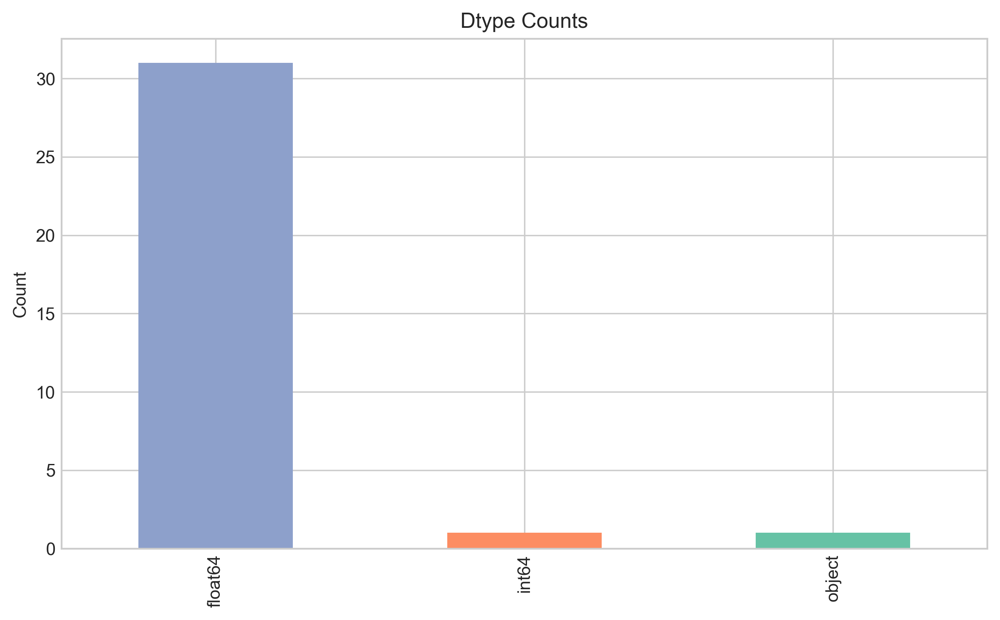

Shape: (569, 33)

Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  pe

In [3]:
shape_info = df.shape
buf = io.StringIO()
df.info(buf=buf)
info_text = buf.getvalue()
desc = df.describe(include='all')

dtype_counts = df.dtypes.value_counts()
fig, ax = plt.subplots()
dtype_counts.plot(kind='bar', ax=ax, color=['#8da0cb', '#fc8d62', '#66c2a5', '#e78ac3'])
ax.set_title("Dtype Counts")
ax.set_ylabel("Count")
fig_path = save_fig(fig, "dtype_counts.png")
print(f"Shape: {shape_info}\n\nInfo:\n{info_text}\n\nDescribe:\n{desc}\nSaved dtype chart: {fig_path}")

Section 3 — Metadata Documentation
Learning Objective: Create a data dictionary for transparency.
Clinician Prompt: Review feature definitions; confirm units and measurement processes.

In [4]:
def guess_description(col):
    if col.lower() == 'diagnosis':
        return 'Malignant (M) or Benign (B) diagnosis label.'
    elif col.lower() == 'id':
        return 'Unique identifier; not predictive.'
    else:
        return 'Cell nucleus feature (mean/se/worst); unitless derived metric.'

metadata = pd.DataFrame({
    'column': df.columns,
    'description': [guess_description(c) for c in df.columns],
    'units': ['unitless' if c.lower() not in ['id', 'diagnosis'] else '-' for c in df.columns],
    'source': ['Kaggle/UC Irvine'] * len(df.columns)
})
metadata_path = os.path.join(DIRS['data'], 'metadata.csv')
metadata.to_csv(metadata_path, index=False)
styled_to_html(metadata.head(20), "metadata_preview.html")
print(f"Saved metadata to: {metadata_path}")

,column,description,units,source
0,id,Unique identifier; not predictive.,-,Kaggle/UC Irvine
1,diagnosis,Malignant (M) or Benign (B) diagnosis label.,-,Kaggle/UC Irvine
2,radius_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
3,texture_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
4,perimeter_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
5,area_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
6,smoothness_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
7,compactness_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
8,concavity_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine
9,concave points_mean,Cell nucleus feature (mean/se/worst); unitless derived metric.,unitless,Kaggle/UC Irvine


Saved metadata to: data\metadata.csv


Section 4 — Missing Data Analysis
Learning Objective: Quantify and visualize missingness patterns.
Clinician Prompt: Assess whether missingness could bias conclusions.

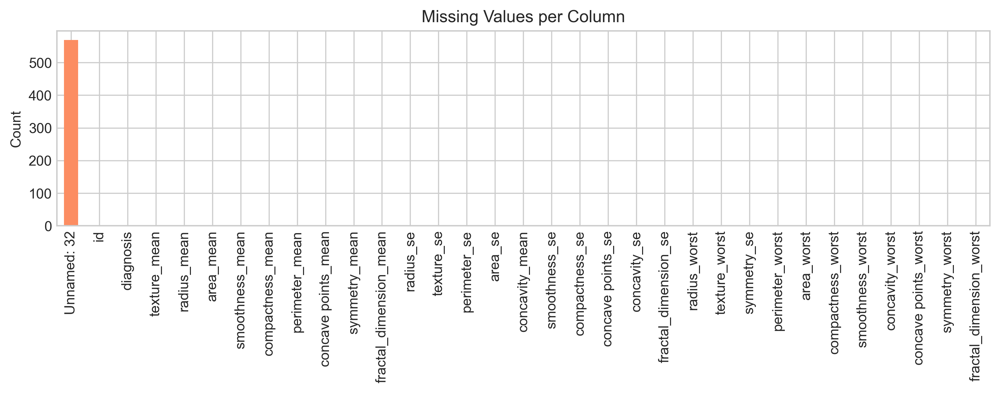

Optional library 'missingno' not available. pip install missingno
No critical missingness expected in this dataset; proceed if counts are zero.


In [5]:
missing_counts = df.isna().sum()
fig, ax = plt.subplots(figsize=(10, 4))
missing_counts.sort_values(ascending=False).plot(kind='bar', ax=ax, color="#fc8d62")
ax.set_title("Missing Values per Column")
ax.set_ylabel("Count")
save_fig(fig, "missing_counts.png")

if MSNO_AVAILABLE:
    fig = plt.figure(figsize=(8, 4))
    msno.matrix(df)
    save_fig(plt.gcf(), "missing_matrix.png")
    fig = plt.figure(figsize=(8, 4))
    msno.bar(df)
    save_fig(plt.gcf(), "missing_bar.png")
else:
    safe_install_msg('missingno', "pip install missingno")

print("No critical missingness expected in this dataset; proceed if counts are zero.")

Section 5 — Duplicate & Zero-Value Analysis
Learning Objective: Identify duplicates and invalid zeros; decide remediation.
Clinician Prompt: Verify if zeros are biologically possible; otherwise impute or cap.

Duplicate rows: 0


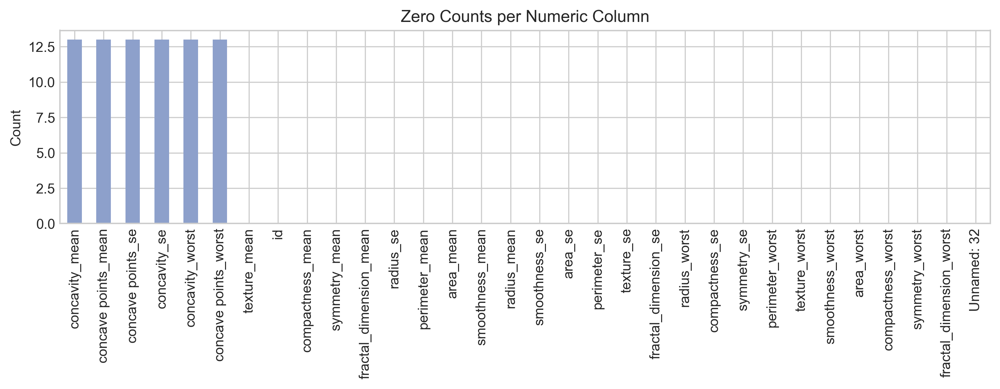

In [6]:
dup_count = df.duplicated().sum()
print(f"Duplicate rows: {dup_count}")
if dup_count > 0:
    df = df.drop_duplicates().reset_index(drop=True)
    print(f"Dropped duplicates; new shape: {df.shape}")

zero_counts = (df.select_dtypes(include=[np.number]) == 0).sum()
fig, ax = plt.subplots(figsize=(10, 4))
zero_counts.sort_values(ascending=False).plot(kind='bar', ax=ax, color="#8da0cb")
ax.set_title("Zero Counts per Numeric Column")
ax.set_ylabel("Count")
save_fig(fig, "zero_counts.png")

# Strategy: For key anatomical features, zeros are unlikely; convert zeros to NaN and impute
feature_like_radius = [c for c in df.columns if ('radius' in c.lower() or 'perimeter' in c.lower() or 'area' in c.lower()) and df[c].dtype != 'O']
for c in feature_like_radius:
    zero_mask = df[c] == 0
    if zero_mask.any():
        df.loc[zero_mask, c] = np.nan
        df[c].fillna(df[c].median(), inplace=True)

Section 6 — Target (Diagnosis) Analysis
Learning Objective: Understand target distribution and potential imbalance.
Clinician Prompt: Consider clinical cost of class imbalance in evaluation.

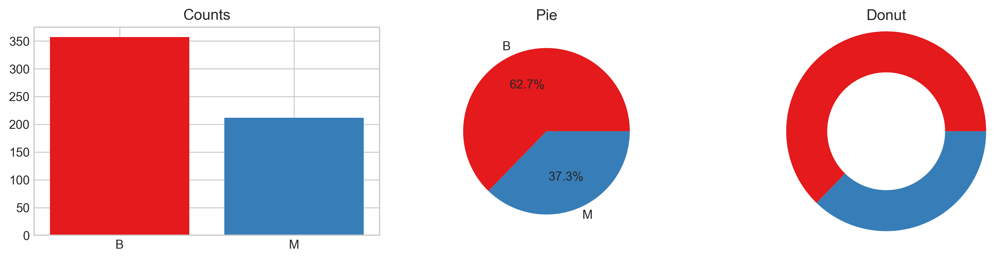

Diagnosis counts:
diagnosis
B    357
M    212
Name: count, dtype: int64
Percentages:
diagnosis
B    62.74
M    37.26
Name: count, dtype: float64


In [7]:
if 'diagnosis' in df.columns:
    target_counts = df['diagnosis'].value_counts()
    target_pct = target_counts / target_counts.sum() * 100
    fig, axes = plt.subplots(1, 3, figsize=(12, 3))
    axes[0].bar(target_counts.index, target_counts.values, color=["#e41a1c", "#377eb8"]) 
    axes[0].set_title("Counts")
    axes[1].pie(target_counts.values, labels=target_counts.index, autopct='%1.1f%%', colors=["#e41a1c", "#377eb8"])
    axes[1].set_title("Pie")
    wedges, texts = axes[2].pie(target_counts.values, colors=["#e41a1c", "#377eb8"], radius=1.2)
    centre = plt.Circle((0, 0), 0.7, color='white')
    axes[2].add_artist(centre)
    axes[2].set_title("Donut")
    save_fig(fig, "diagnosis_distribution.png")
    print(f"Diagnosis counts:\n{target_counts}\nPercentages:\n{target_pct.round(2)}")

Section 7 — Encode Target
Learning Objective: Convert diagnosis to binary (M=1, B=0) for modeling.
Clinician Prompt: Confirm encoding aligns with clinical interpretations.

In [8]:
if 'diagnosis' in df.columns:
    df['target'] = df['diagnosis'].map({'M': 1, 'B': 0})
    print(df[['diagnosis', 'target']].head())

  diagnosis  target
0         M       1
1         M       1
2         M       1
3         M       1
4         M       1


Section 8 — Uniqueness & Snapshots
Learning Objective: Check per-column uniqueness; save raw vs cleaned snapshots.
Clinician Prompt: Ensure identifiers are unique and removed from modeling.

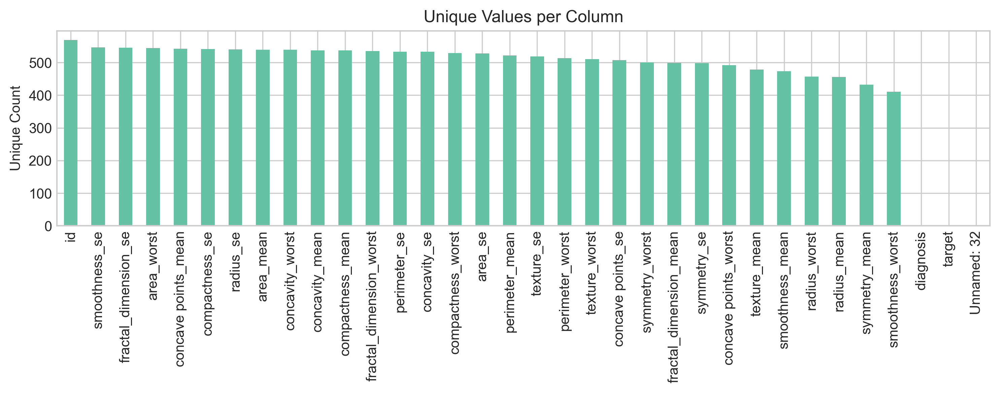

In [9]:
uniq = df.nunique()
fig, ax = plt.subplots(figsize=(10, 4))
uniq.sort_values(ascending=False).plot(kind='bar', ax=ax, color="#66c2a5")
ax.set_title("Unique Values per Column")
ax.set_ylabel("Unique Count")
save_fig(fig, "unique_counts.png")

df_raw.head(10).to_csv(os.path.join(DIRS['data'], 'raw_snapshot.csv'), index=False)
df.head(10).to_csv(os.path.join(DIRS['data'], 'cleaned_snapshot.csv'), index=False)

Section 9 — Univariate Histograms & KDE (Grid + Individual)
Learning Objective: Examine distributions for all numeric features.
Clinician Prompt: Identify features with meaningful separation by diagnosis.

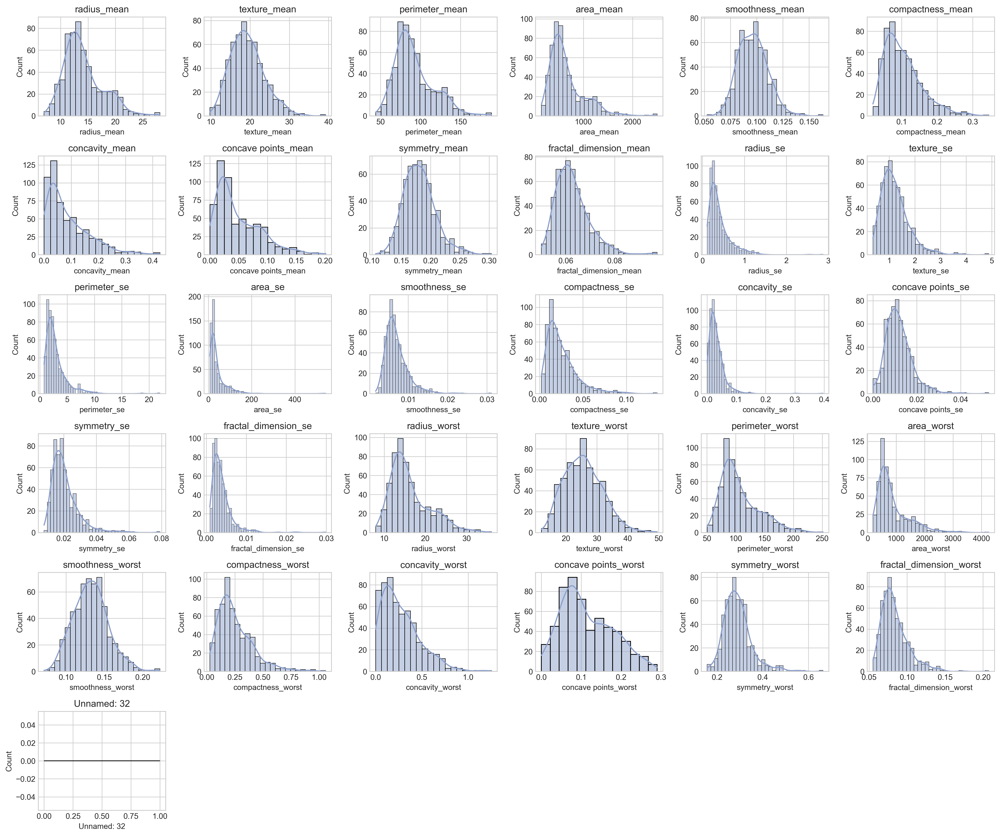

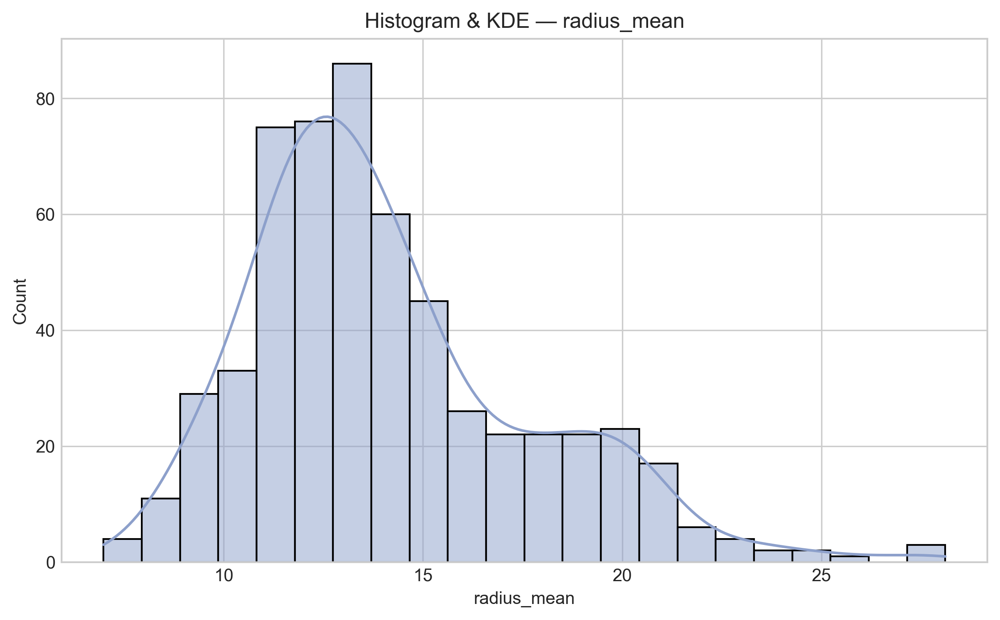

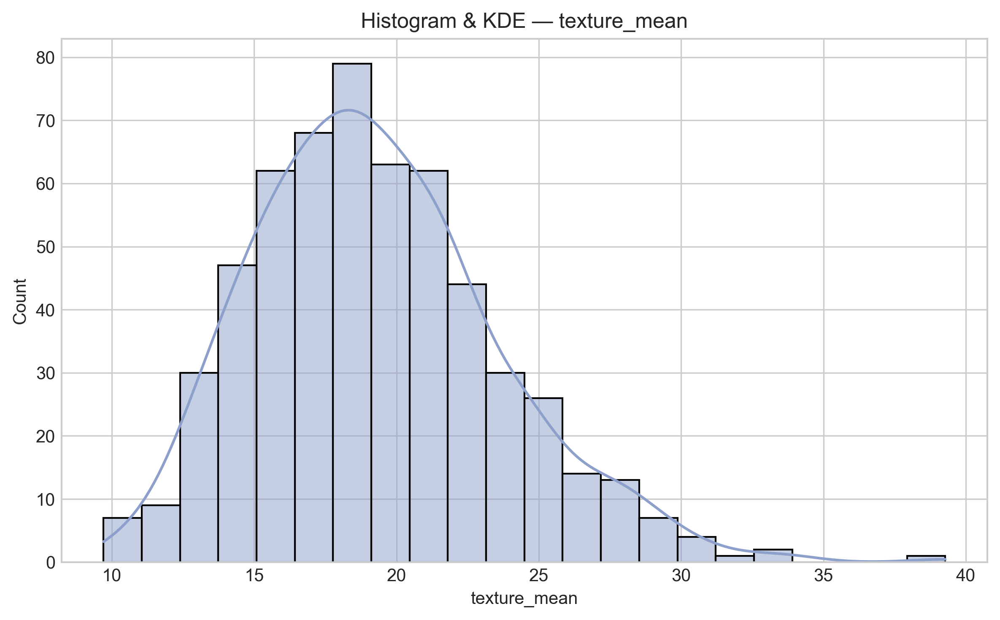

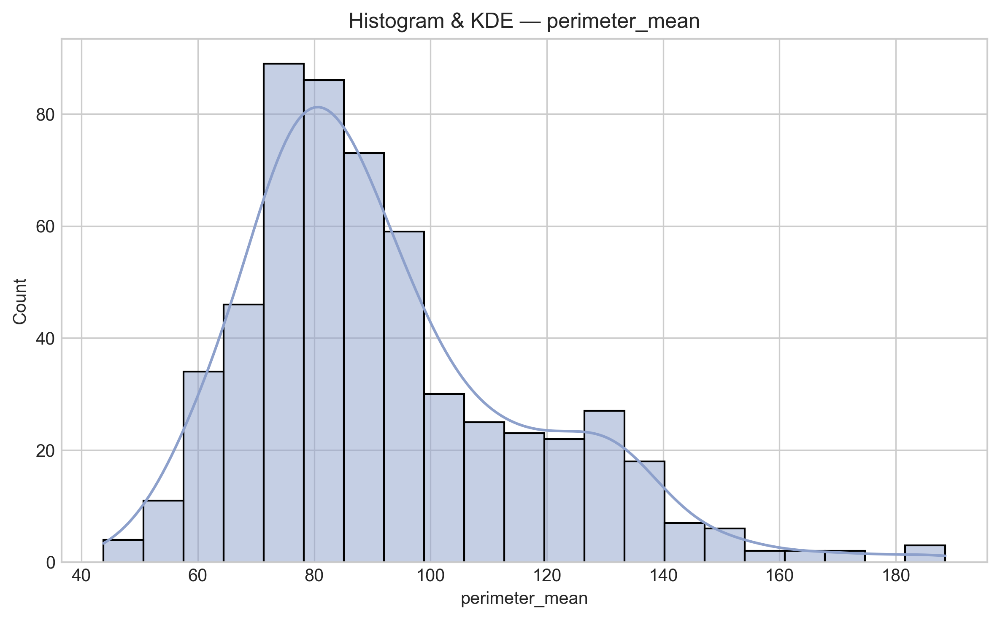

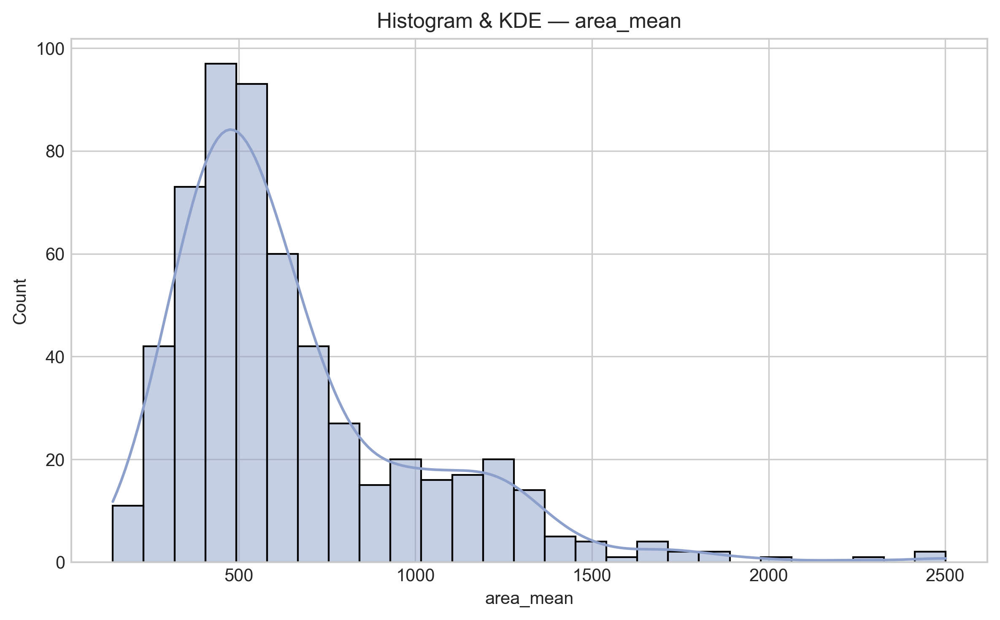

...

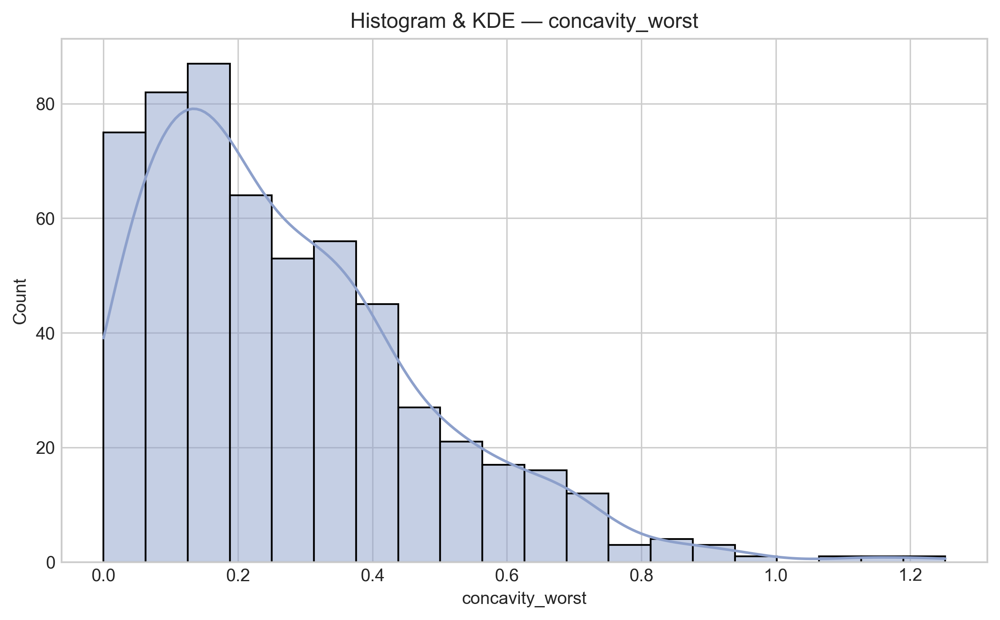

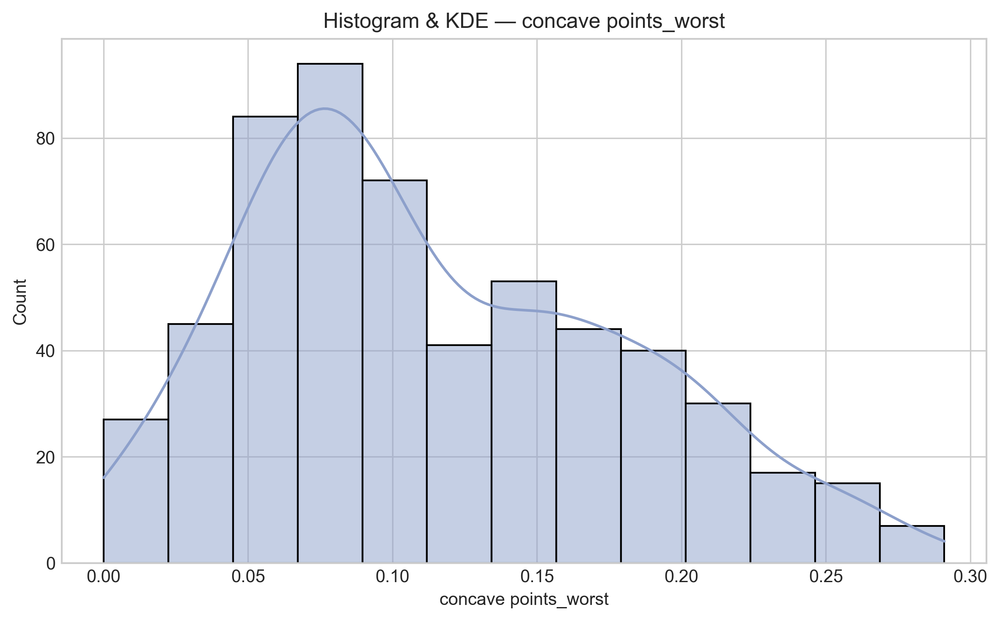

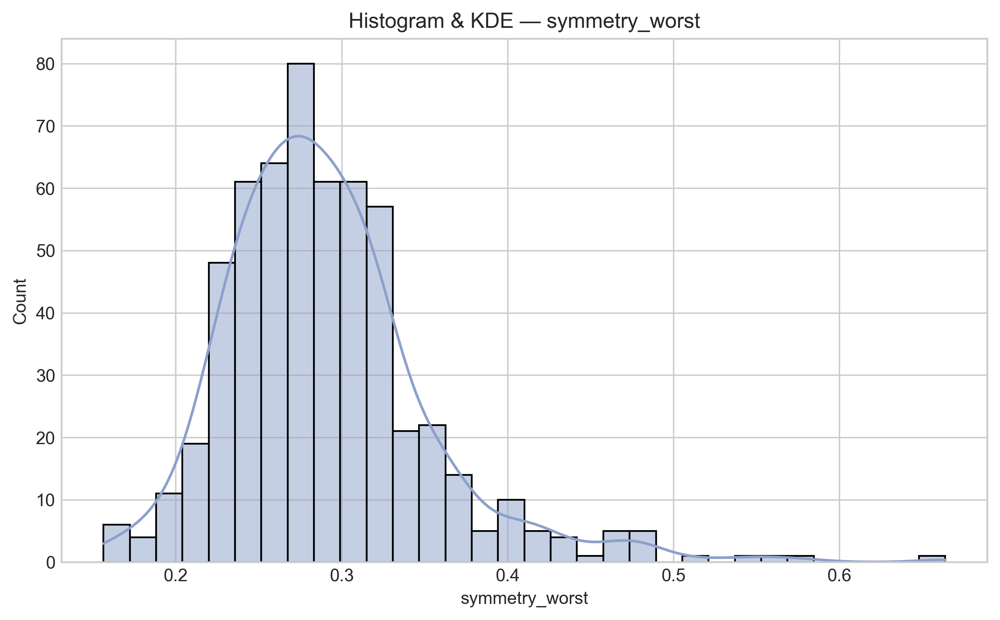

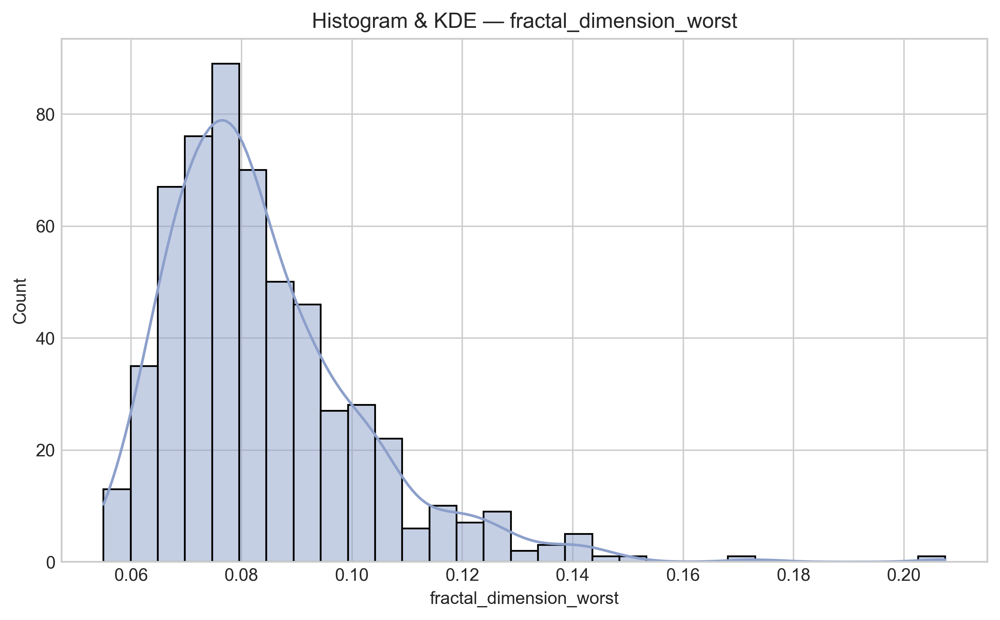

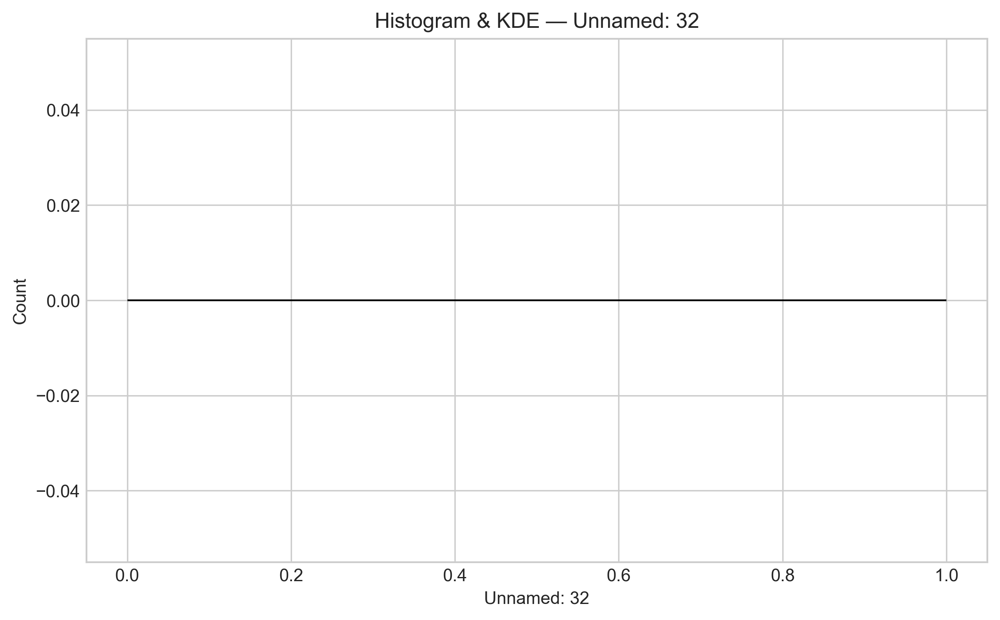

In [10]:
num_cols = df.select_dtypes(include=[np.number]).columns.tolist()
if 'target' in num_cols:
    feature_cols = [c for c in num_cols if c != 'target' and c.lower() != 'id']
else:
    feature_cols = [c for c in num_cols if c.lower() != 'id']

grid_cols = 6
grid_rows = int(np.ceil(len(feature_cols) / grid_cols))
fig, axes = plt.subplots(grid_rows, grid_cols, figsize=(grid_cols*3, grid_rows*2.5))
axes = axes.ravel()
for i, c in enumerate(feature_cols):
    sns.histplot(df[c], kde=True, ax=axes[i], color="#8da0cb")
    axes[i].set_title(c)
for j in range(i+1, len(axes)):
    axes[j].axis('off')
save_fig(fig, "hist_grid_all_numeric.png")

for c in feature_cols:
    fig, ax = plt.subplots()
    sns.histplot(df[c], kde=True, ax=ax, color="#8da0cb")
    ax.set_title(f"Histogram & KDE — {c}")
    save_fig(fig, f"hist_{fmt_title(c)}.png")

Section 10 — Normality Q-Q, Skewness, Kurtosis
Learning Objective: Assess normality and tail behavior to inform modeling.
Clinician Prompt: Non-normal features may require robust methods.

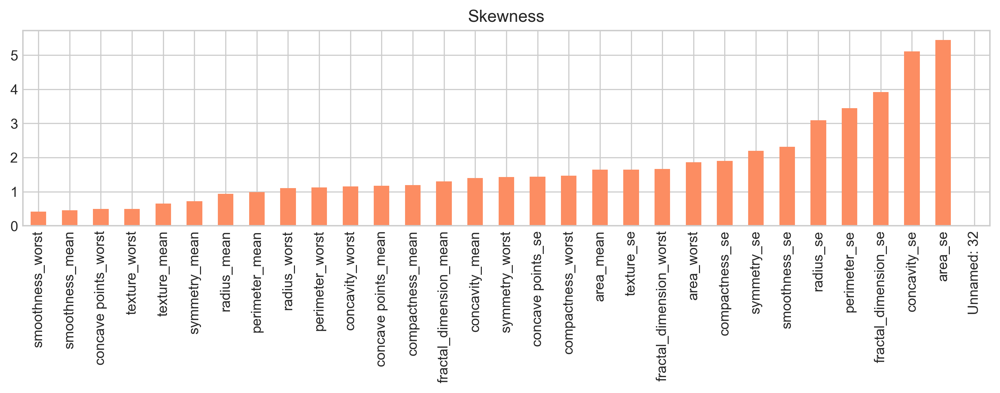

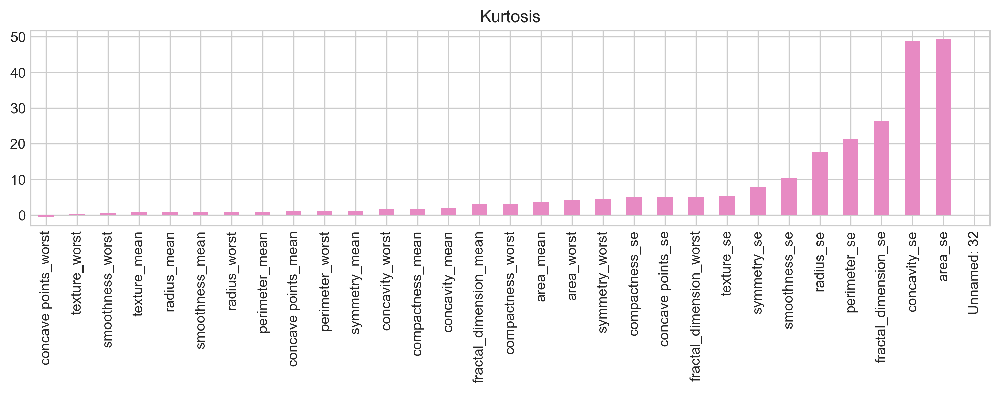

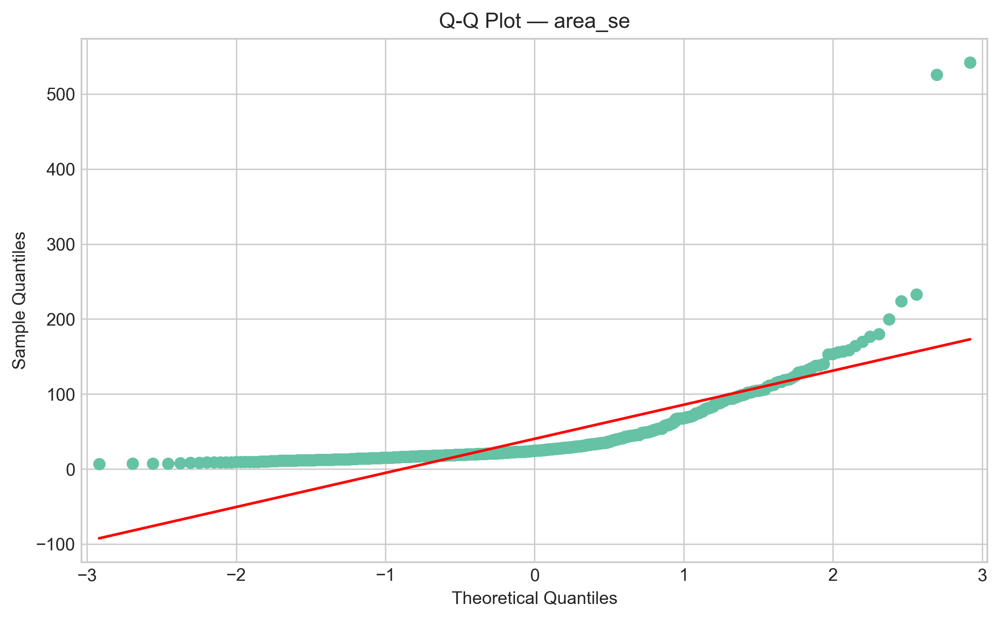

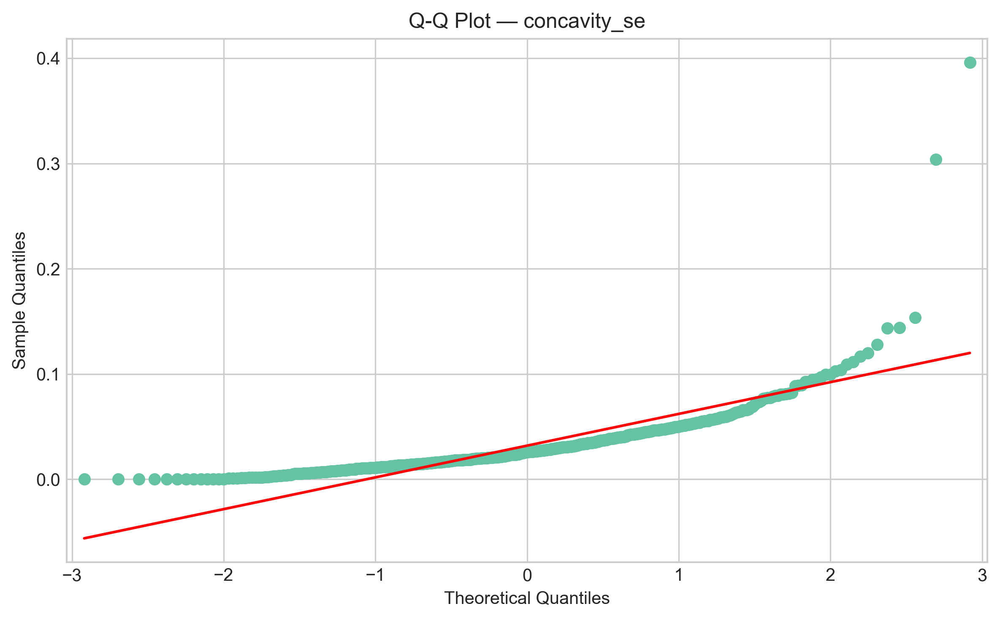

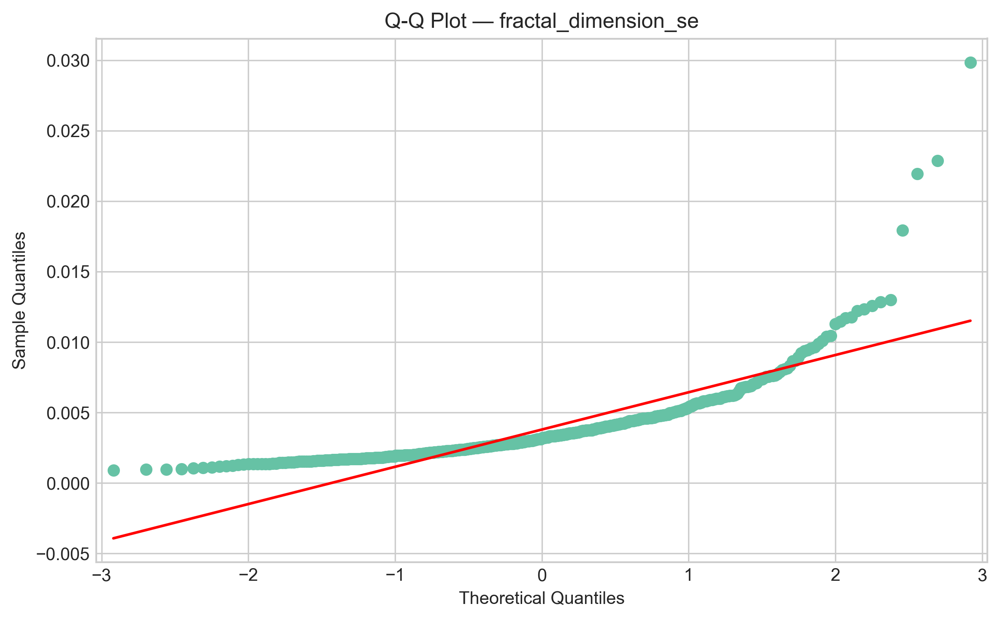

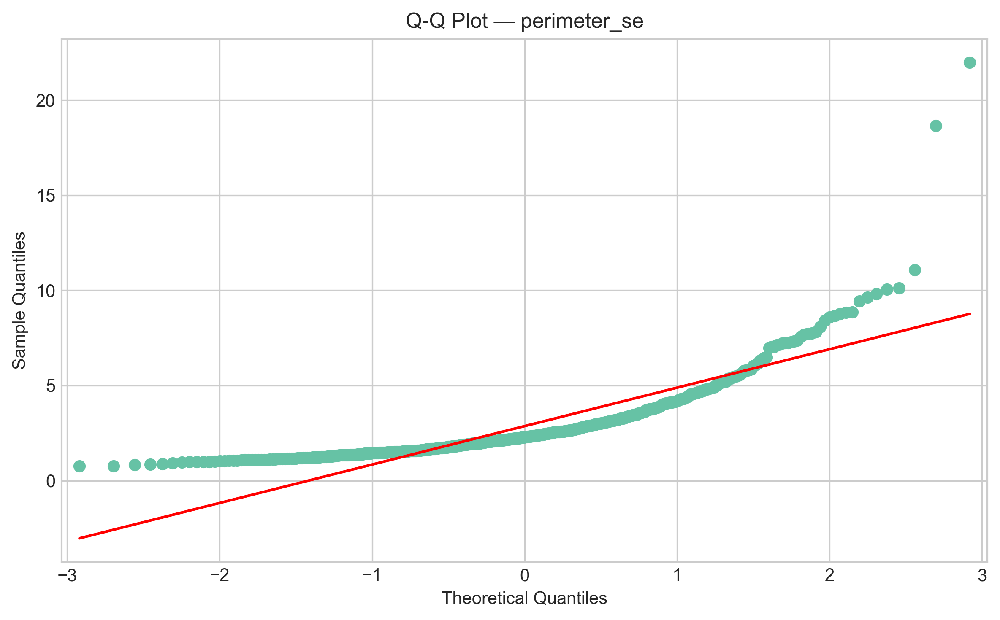

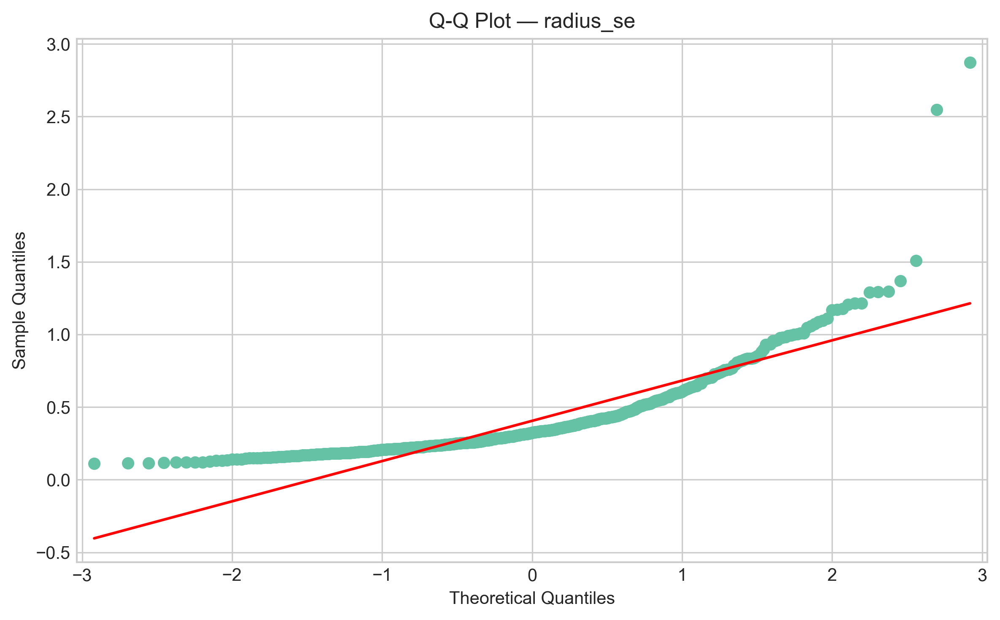

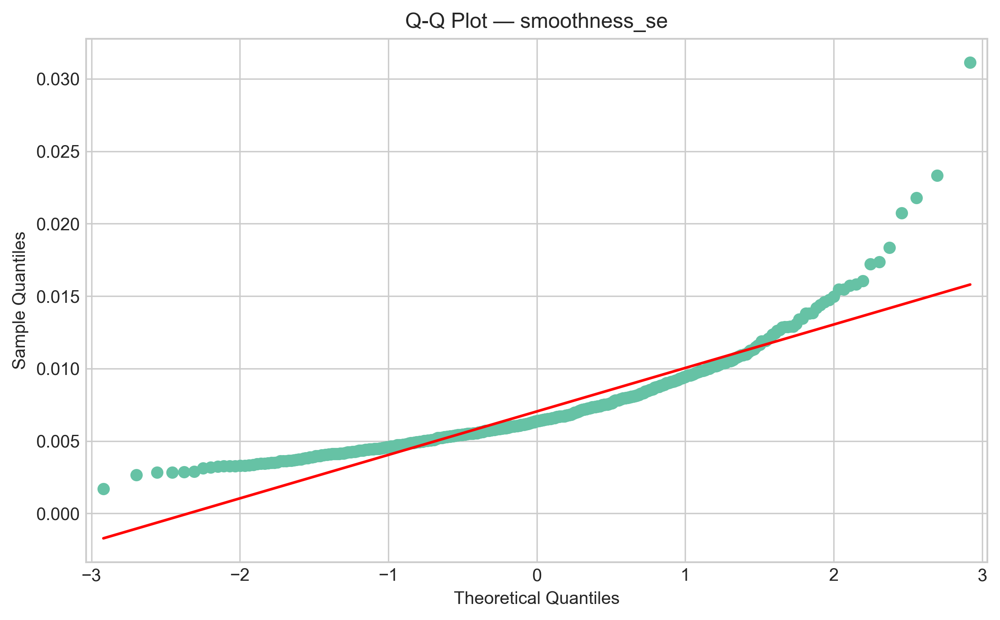

<Figure size 2400x1500 with 0 Axes>

<Figure size 2400x1500 with 0 Axes>

<Figure size 2400x1500 with 0 Axes>

<Figure size 2400x1500 with 0 Axes>

<Figure size 2400x1500 with 0 Axes>

<Figure size 2400x1500 with 0 Axes>

In [11]:
skewness = df[feature_cols].skew()
kurtosis = df[feature_cols].kurt()
fig, ax = plt.subplots(figsize=(10, 4))
skewness.sort_values().plot(kind='bar', ax=ax, color="#fc8d62")
ax.set_title("Skewness")
save_fig(fig, "skewness.png")

fig, ax = plt.subplots(figsize=(10, 4))
kurtosis.sort_values().plot(kind='bar', ax=ax, color="#e78ac3")
ax.set_title("Kurtosis")
save_fig(fig, "kurtosis.png")

top_skewed = skewness.abs().sort_values(ascending=False).head(6).index.tolist()
import statsmodels.api as sm
for c in top_skewed:
    fig = plt.figure()
    sm.qqplot(df[c], line='s')
    plt.title(f"Q-Q Plot — {c}")
    save_fig(plt.gcf(), f"qq_{fmt_title(c)}.png")

Section 11 — Grouped Statistics by Diagnosis
Learning Objective: Summarize central tendency and dispersion by class.
Clinician Prompt: Focus on features with largest mean differences.

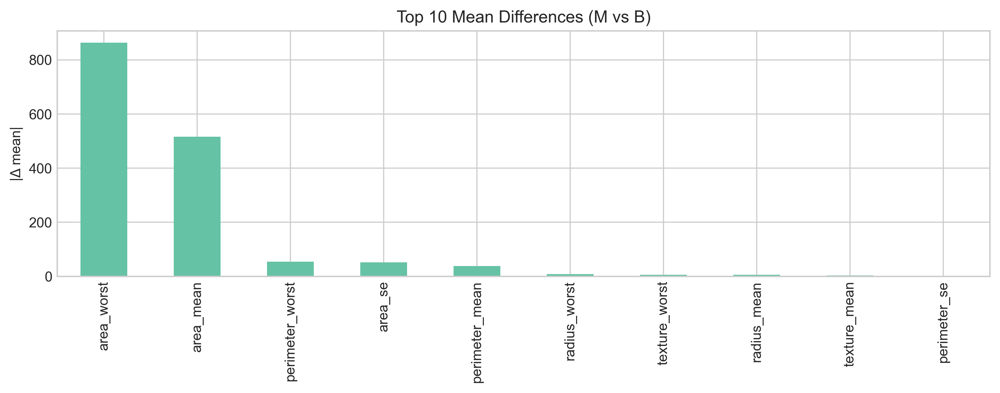

In [12]:
if 'target' in df.columns:
    grouped_stats = df.groupby('target')[feature_cols].agg(['mean', 'median', 'std'])
    grouped_stats.to_csv(os.path.join(DIRS['reports'], 'grouped_stats_by_diagnosis.csv'))
    # Top discriminative features by mean difference
    means = df.groupby('target')[feature_cols].mean()
    mean_diff = (means.loc[1] - means.loc[0]).abs().sort_values(ascending=False)
    top10 = mean_diff.head(10)
    fig, ax = plt.subplots(figsize=(10, 4))
    top10.plot(kind='bar', ax=ax, color="#66c2a5")
    ax.set_title("Top 10 Mean Differences (M vs B)")
    ax.set_ylabel("|Δ mean|")
    save_fig(fig, "top10_mean_diff.png")

Section 12 — Violin, Box, Swarm/Strip & Ridge Plots
Learning Objective: Compare distributions across diagnosis visually.
Clinician Prompt: Identify clinically separable features.

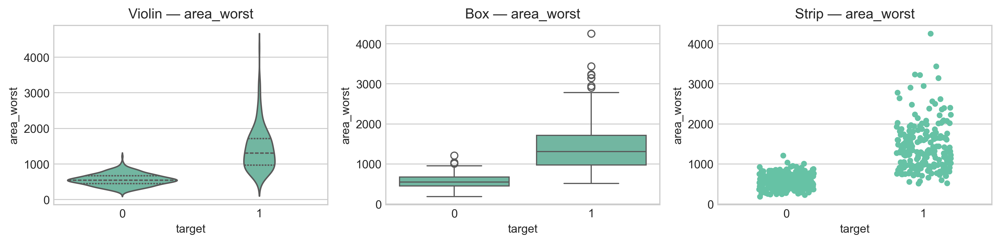

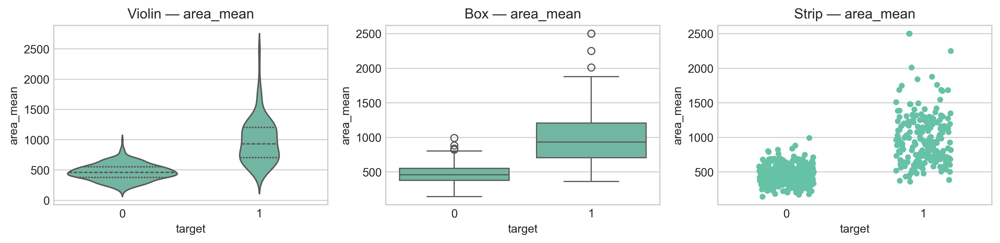

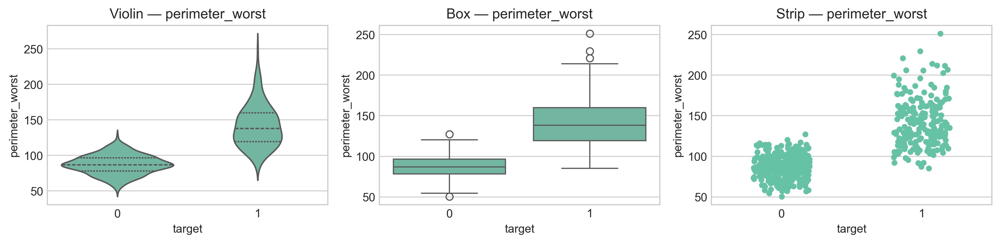

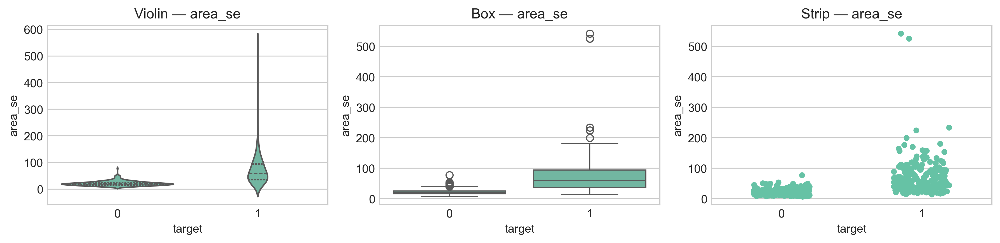

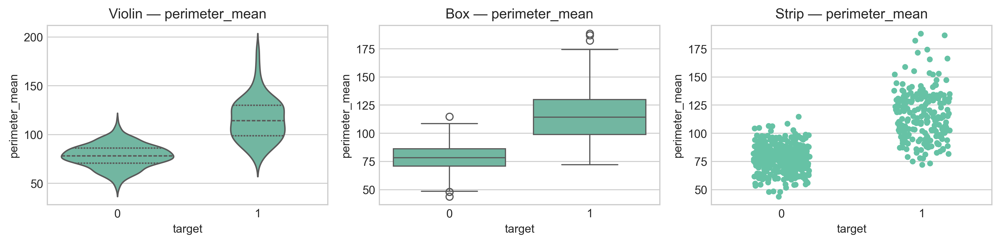

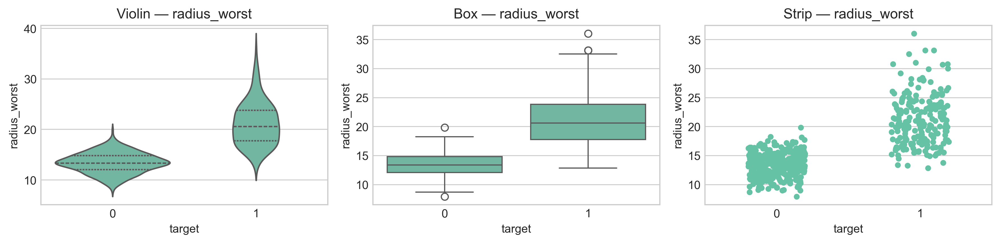

In [13]:
if 'target' in df.columns:
    top_feats = mean_diff.head(6).index.tolist() if 'mean_diff' in locals() else feature_cols[:6]
    for c in top_feats:
        fig, axes = plt.subplots(1, 3, figsize=(12, 3))
        sns.violinplot(data=df, x='target', y=c, inner='quartile', ax=axes[0])
        axes[0].set_title(f"Violin — {c}")
        sns.boxplot(data=df, x='target', y=c, ax=axes[1])
        axes[1].set_title(f"Box — {c}")
        sns.stripplot(data=df, x='target', y=c, ax=axes[2], jitter=0.2)
        axes[2].set_title(f"Strip — {c}")
        save_fig(fig, f"dist_compare_{fmt_title(c)}.png")

    # Ridge plots (joy plots)
    try:
        import joypy
        fig, ax = plt.subplots(figsize=(10, 6))
        _ = joypy.joyplot(df[top_feats + ['target']], by='target', figsize=(10, 6))
        save_fig(plt.gcf(), "ridge_plots_top6.png")
    except Exception:
        pass

Section 13 — Correlation Heatmap & Dendrogram
Learning Objective: Identify correlated features and clusters.
Clinician Prompt: Beware multicollinearity in models.

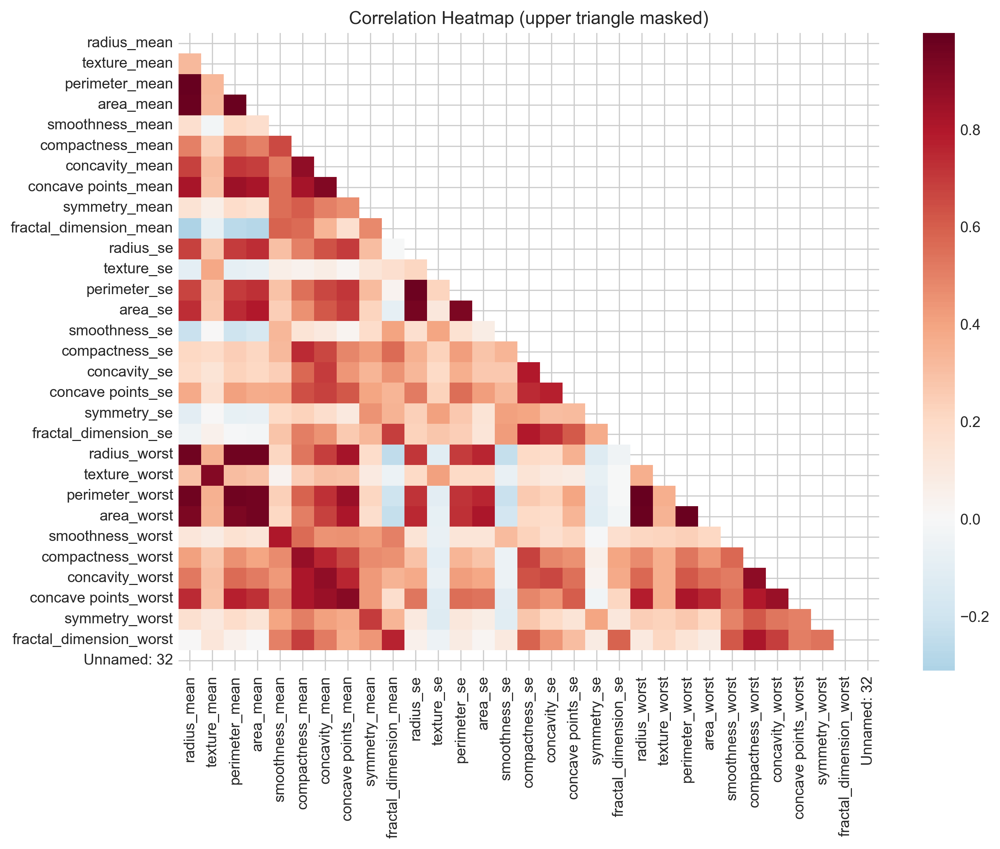

<Figure size 2400x1800 with 0 Axes>

In [14]:
corr = df[feature_cols].corr()
fig, ax = plt.subplots(figsize=(10, 8))
mask = np.triu(np.ones_like(corr, dtype=bool))
sns.heatmap(corr, mask=mask, cmap='RdBu_r', center=0, ax=ax)
ax.set_title("Correlation Heatmap (upper triangle masked)")
save_fig(fig, "corr_heatmap.png")

try:
    import scipy.cluster.hierarchy as sch
    fig = plt.figure(figsize=(8, 6))
    sch.dendrogram(sch.linkage(corr, method='ward'))
    plt.title('Hierarchical Clustering Dendrogram (features)')
    save_fig(plt.gcf(), "corr_dendrogram.png")
except Exception:
    pass

Section 14 — Top Correlated Pairs & Regression
Learning Objective: Visualize strongest linear associations.
Clinician Prompt: Consider redundancy or feature engineering.

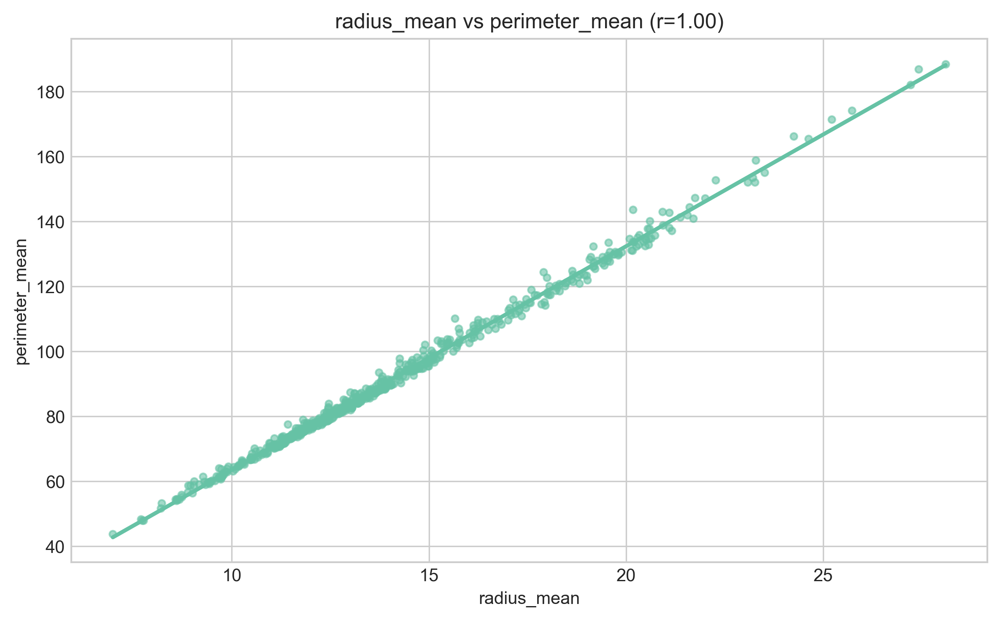

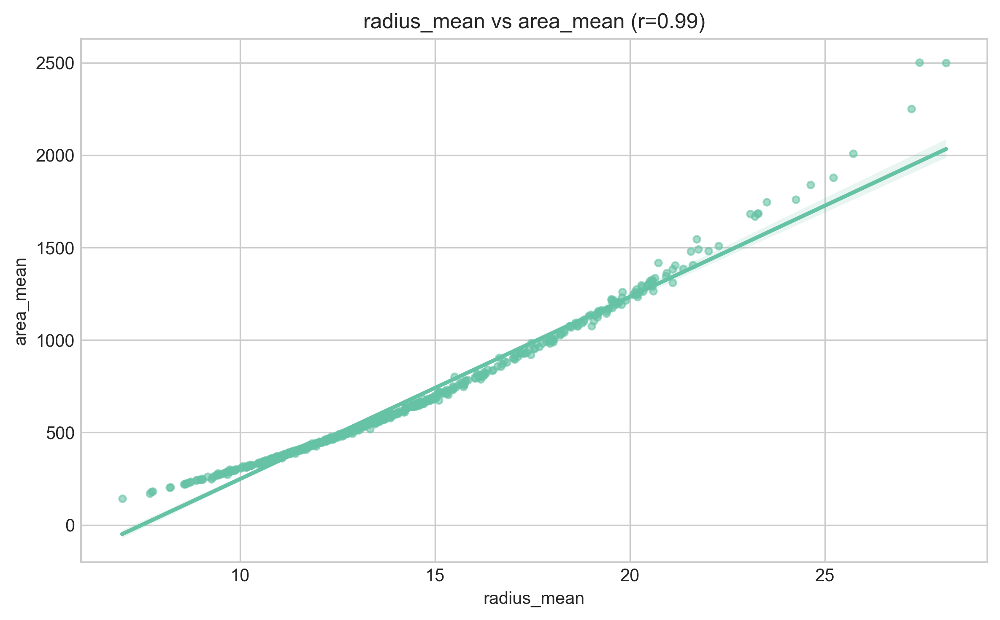

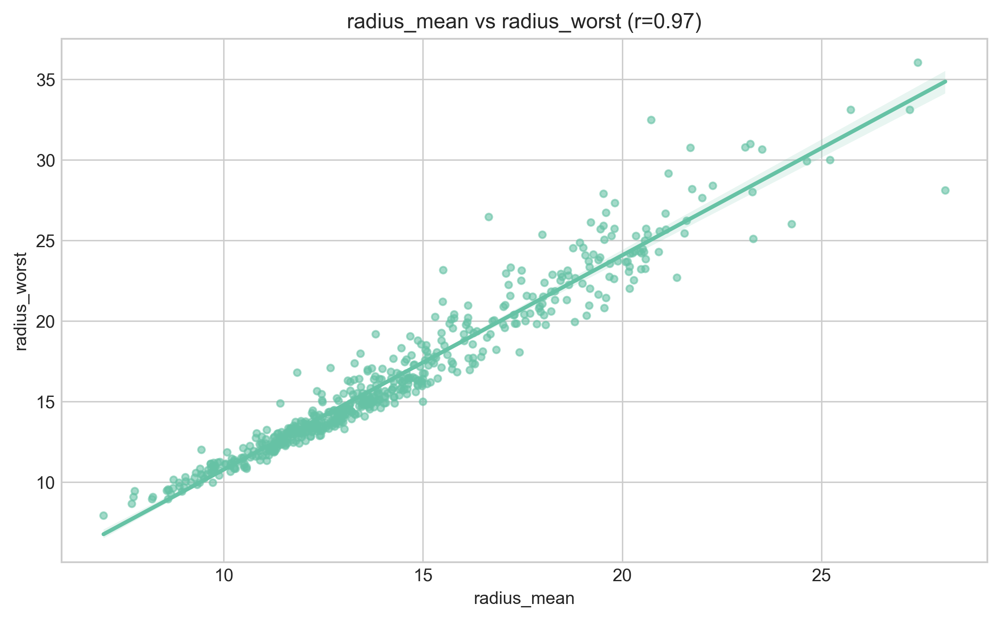

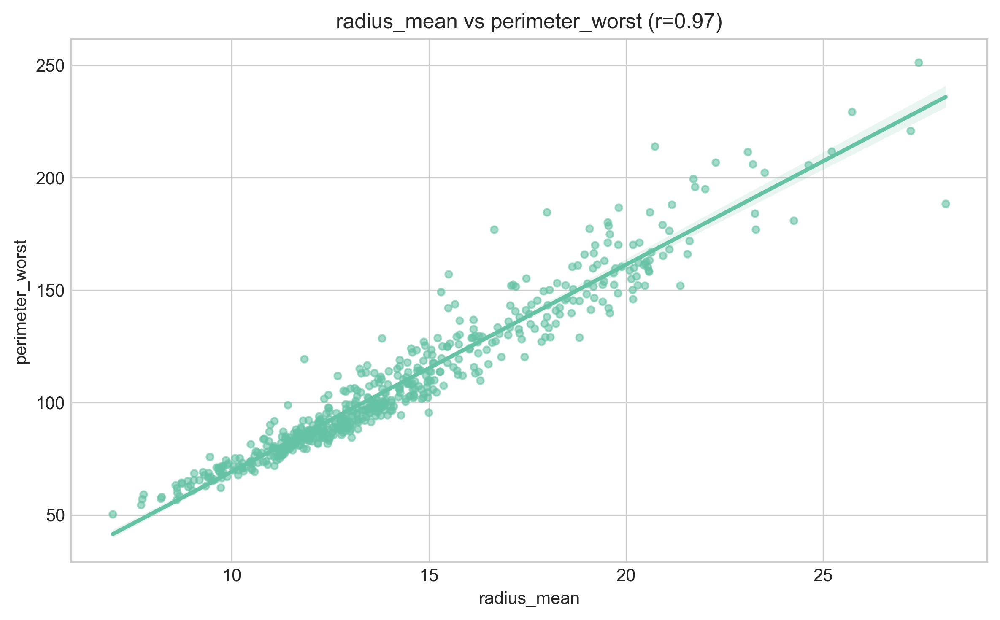

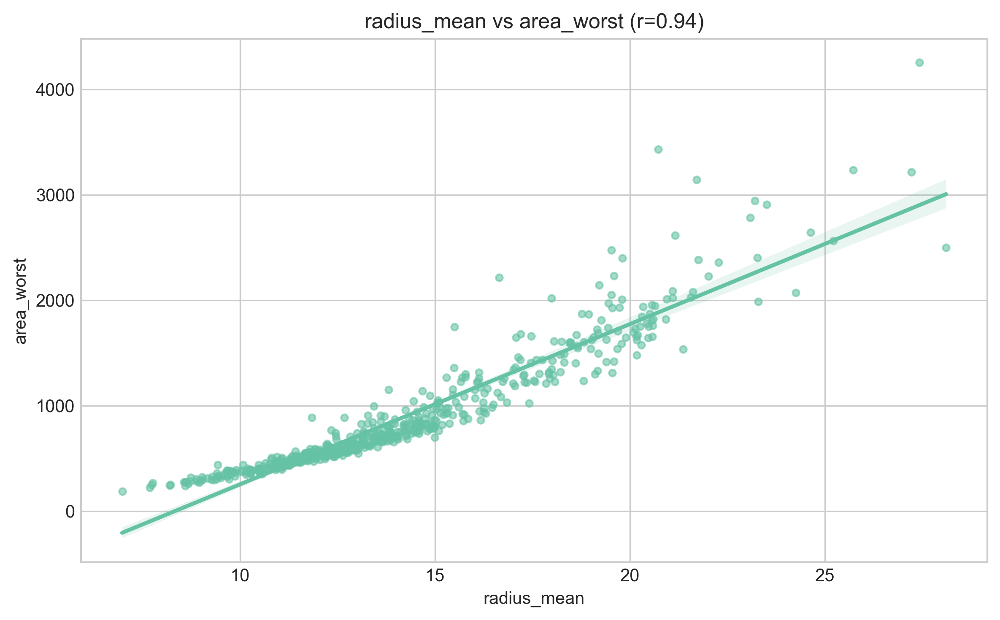

...

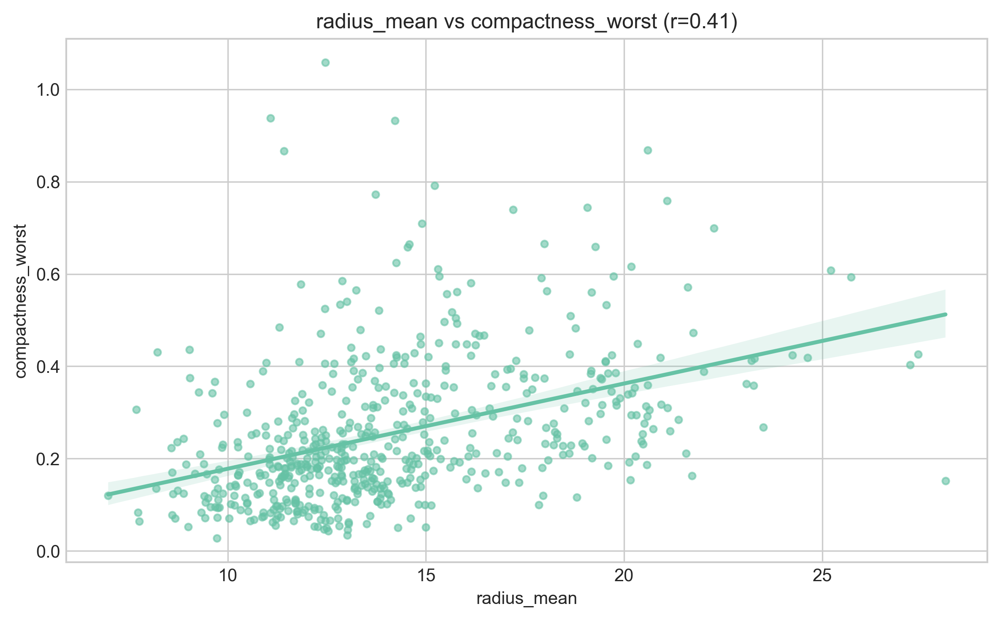

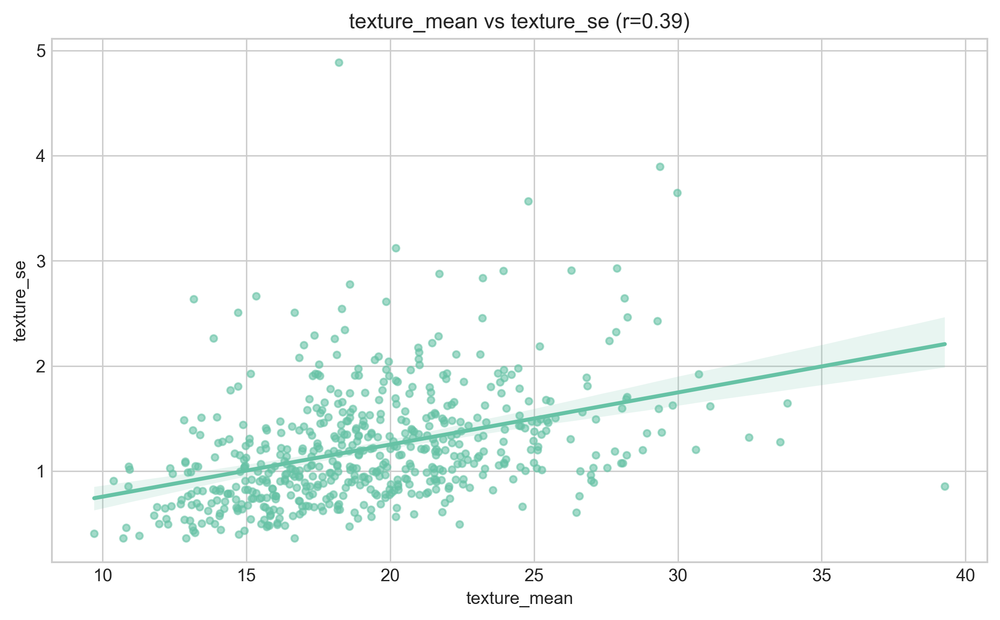

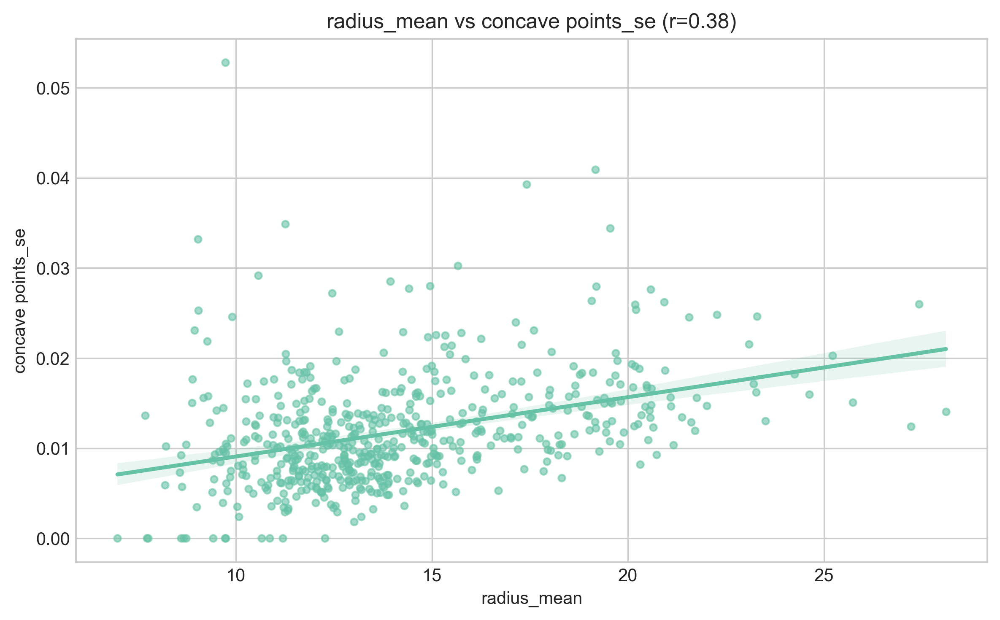

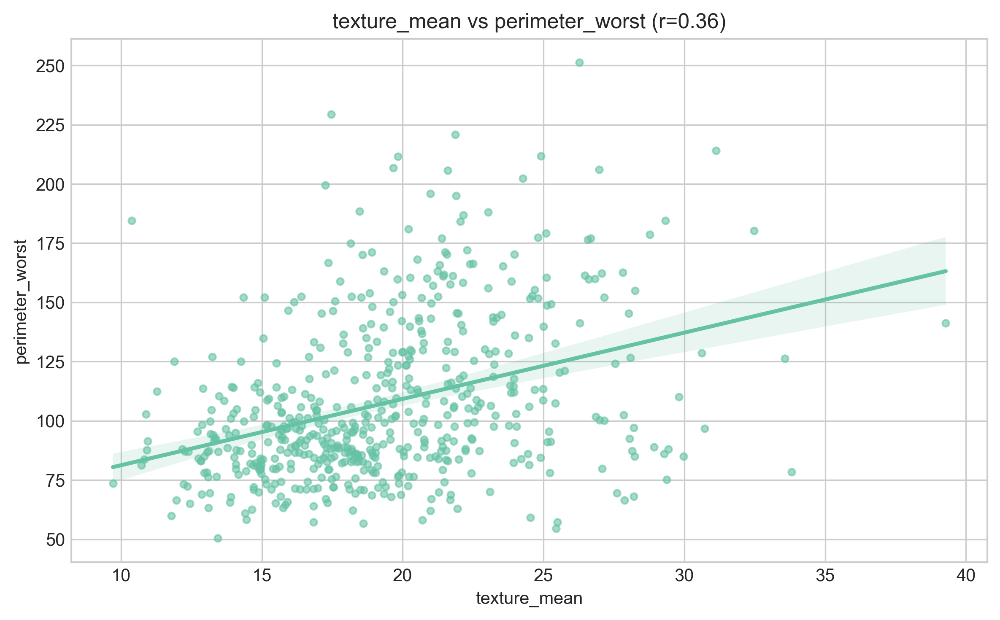

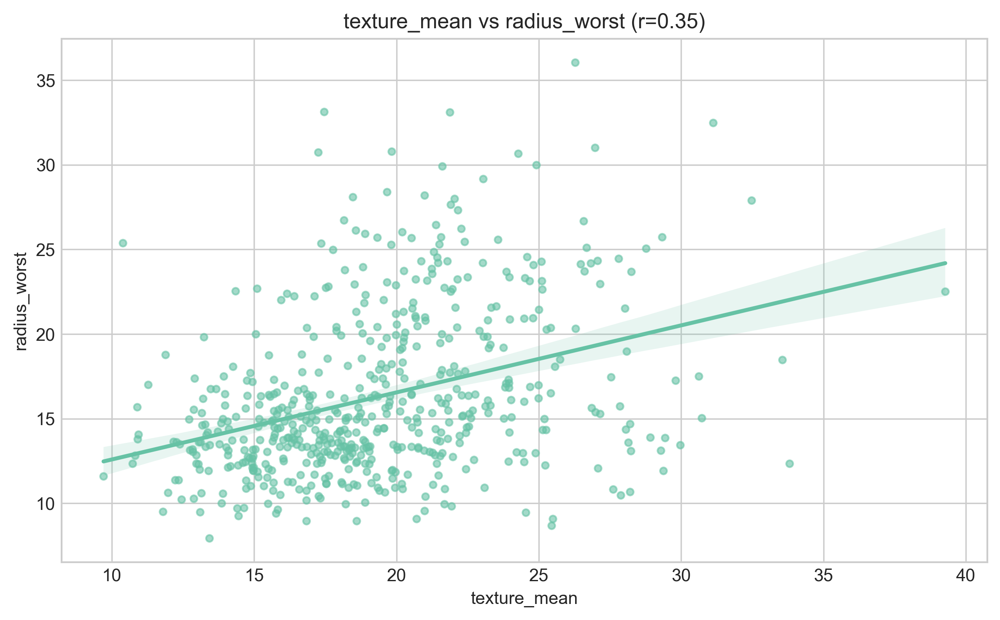

In [15]:
pairs = []
abs_corr = corr.abs()
for i in range(len(abs_corr)):
    for j in range(i+1, len(abs_corr)):
        pairs.append((abs_corr.index[i], abs_corr.columns[j], abs_corr.iloc[i, j]))
pairs_sorted = sorted(pairs, key=lambda x: x[2], reverse=True)[:20]
for a, b, r in pairs_sorted:
    fig, ax = plt.subplots()
    sns.regplot(x=df[a], y=df[b], ax=ax, scatter_kws={'s': 15, 'alpha': 0.6})
    ax.set_title(f"{a} vs {b} (r={r:.2f})")
    save_fig(fig, f"reg_{fmt_title(a)}_{fmt_title(b)}.png")

Section 15 — Pairplot & Joint/Hexbin/KDE Contours
Learning Objective: Explore multivariate relationships in subsets.
Clinician Prompt: Identify clusters or separability by diagnosis.

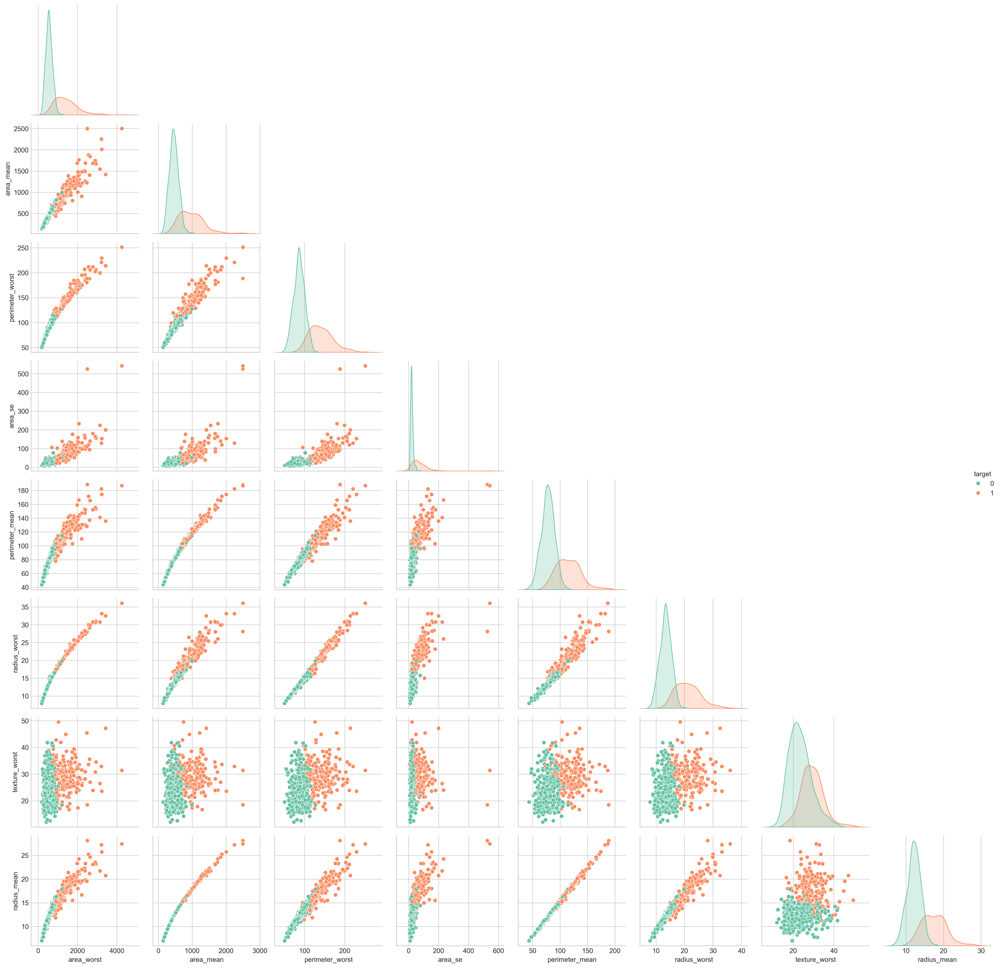

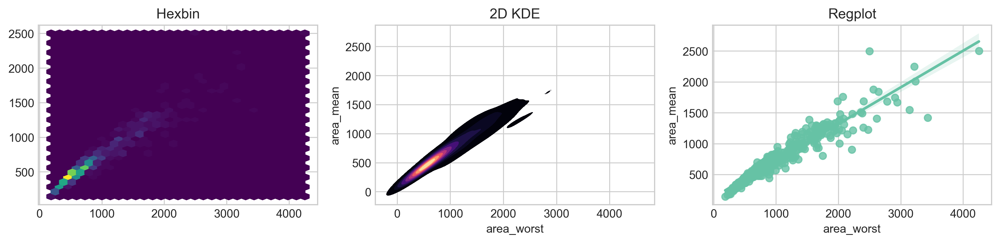

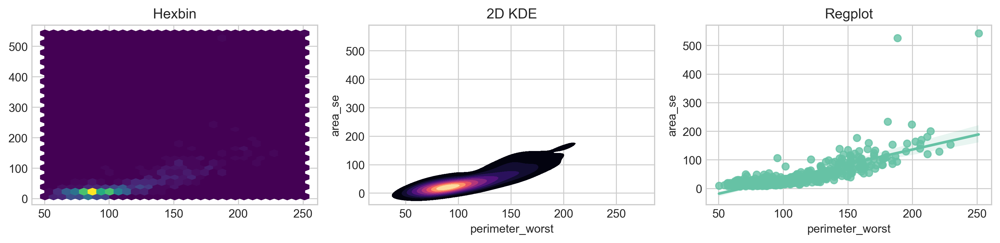

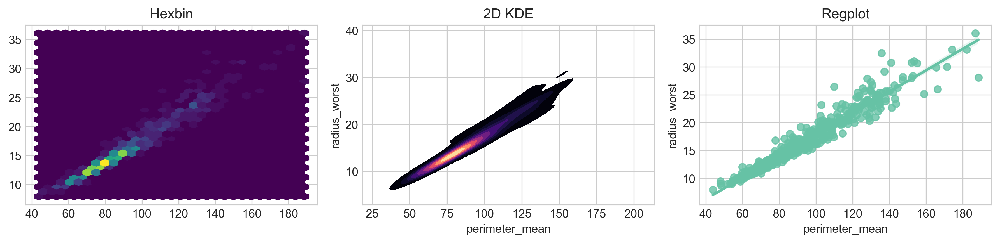

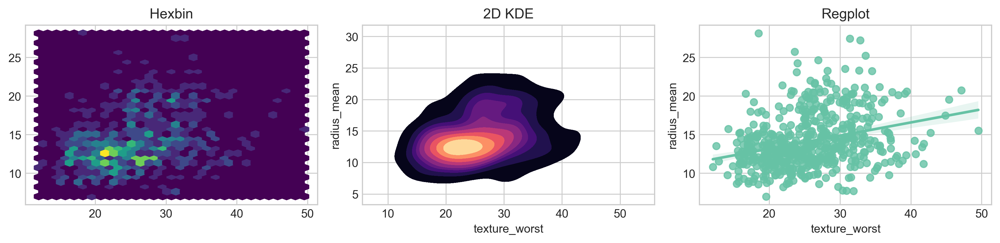

In [16]:
if 'target' in df.columns:
    subset = mean_diff.head(8).index.tolist() if 'mean_diff' in locals() else feature_cols[:8]
    fig = sns.pairplot(df[subset + ['target']], hue='target', corner=True)
    save_fig(fig.fig, "pairplot_top8.png")

    for i in range(0, len(subset)-1, 2):
        x, y = subset[i], subset[i+1]
        fig, axes = plt.subplots(1, 3, figsize=(12, 3))
        sns.jointplot(data=df, x=x, y=y, kind='scatter')
        plt.savefig(os.path.join(DIRS['figures'], f"joint_{fmt_title(x)}_{fmt_title(y)}.png"), dpi=300)
        plt.close()
        axes[0].hexbin(df[x], df[y], gridsize=30, cmap='viridis')
        axes[0].set_title("Hexbin")
        sns.kdeplot(x=df[x], y=df[y], ax=axes[1], fill=True, cmap='magma')
        axes[1].set_title("2D KDE")
        sns.regplot(x=df[x], y=df[y], ax=axes[2])
        axes[2].set_title("Regplot")
        save_fig(fig, f"hex_kde_reg_{fmt_title(x)}_{fmt_title(y)}.png")

Section 16 — Outlier Detection (IQR & Z-score)
Learning Objective: Flag and decide treatment for outliers.
Clinician Prompt: Document rationale for removal vs capping.

In [17]:
outlier_flags = {}
for c in feature_cols:
    q1, q3 = np.percentile(df[c], [25, 75])
    iqr = q3 - q1
    lower, upper = q1 - 1.5*iqr, q3 + 1.5*iqr
    z = (df[c] - df[c].mean()) / (df[c].std() + 1e-9)
    outlier_flags[c] = ((df[c] < lower) | (df[c] > upper) | (z.abs() > 3))

outlier_count = pd.DataFrame({c: outlier_flags[c].sum() for c in feature_cols}, index=['count']).T
styled_to_html(outlier_count.sort_values('count', ascending=False), "outlier_counts.html")
print("Outliers flagged; consider capping to 5th/95th percentiles for robust models.")

,count
area_se,65
radius_se,38
perimeter_se,38
area_worst,35
smoothness_se,30
compactness_se,28
fractal_dimension_se,28
symmetry_se,27
area_mean,25
fractal_dimension_worst,24


Outliers flagged; consider capping to 5th/95th percentiles for robust models.


Section 17 — Scaling Comparison
Learning Objective: Evaluate scaler impacts on distribution.
Clinician Prompt: Choose scaling consistent with clinical interpretability.

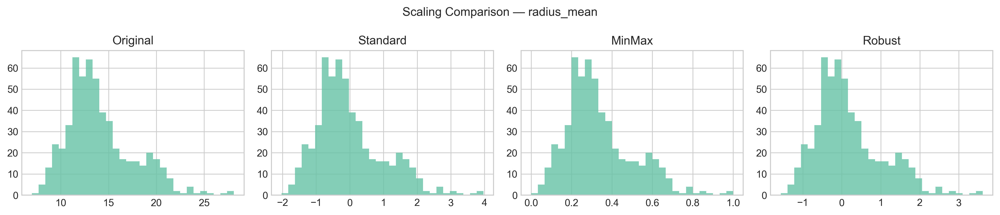

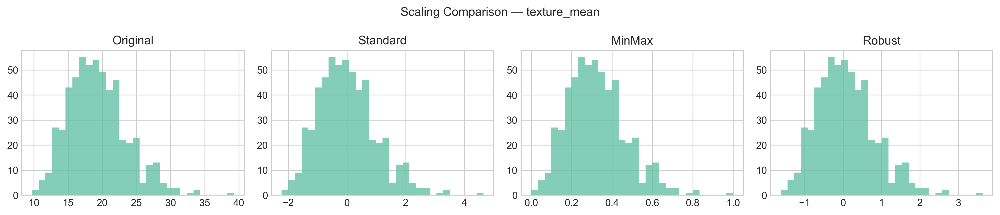

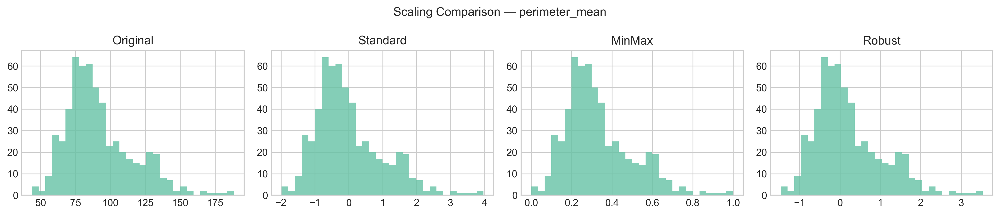

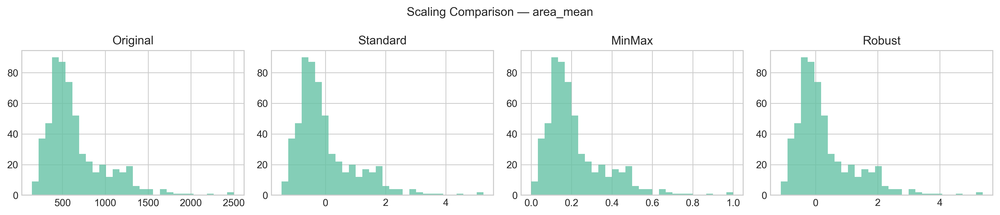

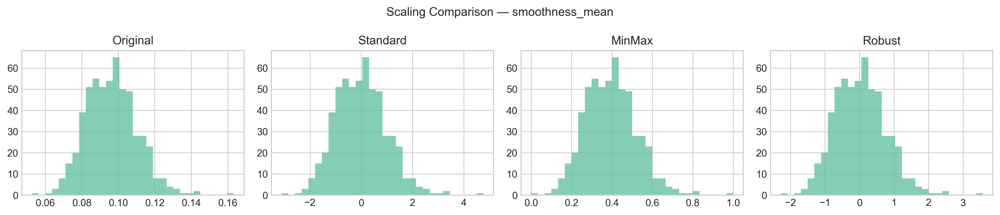

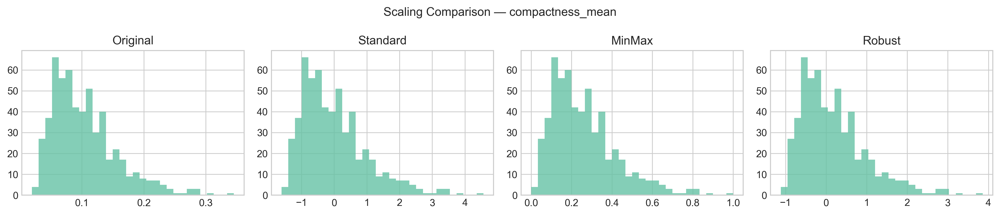

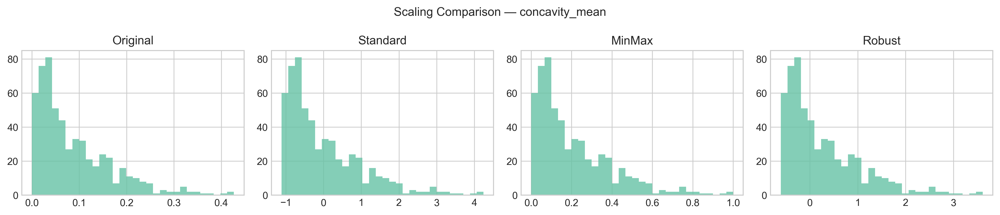

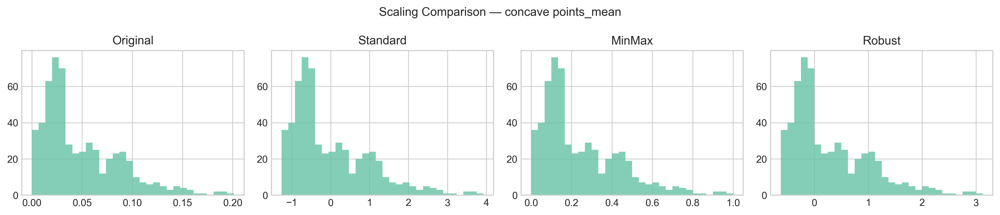

In [18]:
for c in feature_cols[:8]:
    plot_compare_scalers(df[c], name_prefix="section17")

Section 18 — Multivariate Visuals (Parallel, Andrews, Radviz)
Learning Objective: Visualize complex patterns across features.
Clinician Prompt: Inspect grouping by diagnosis.

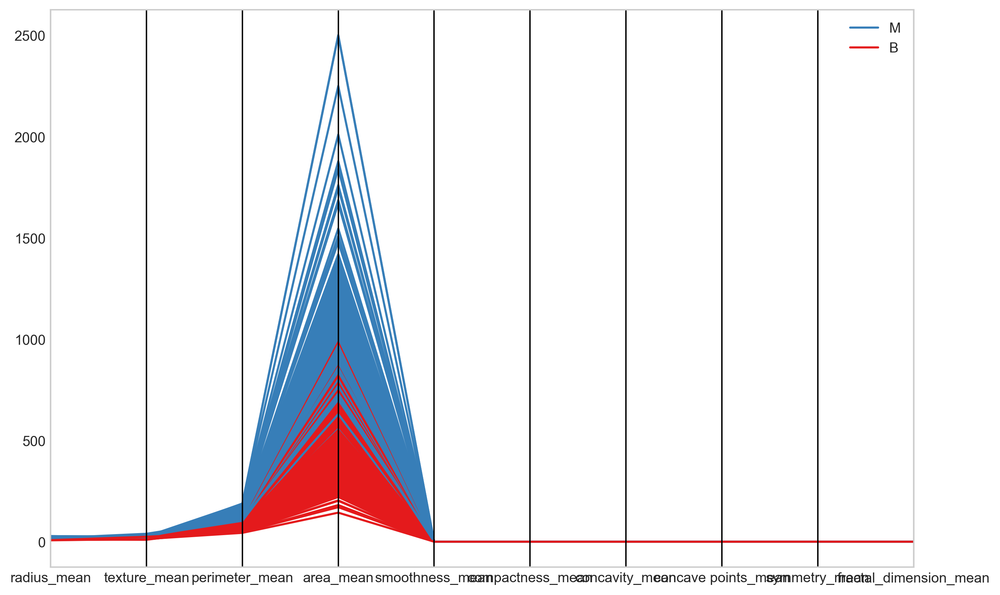

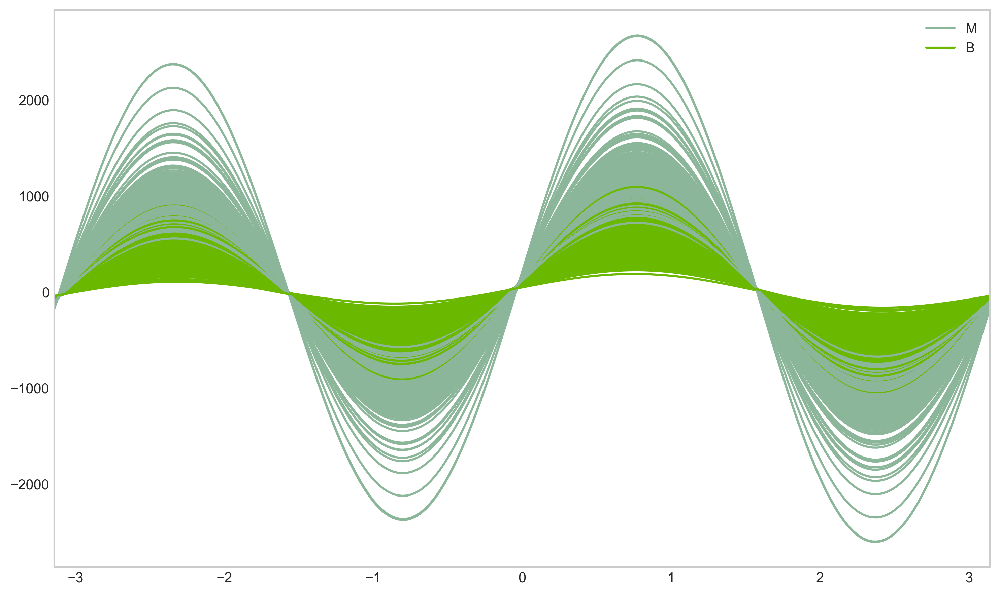

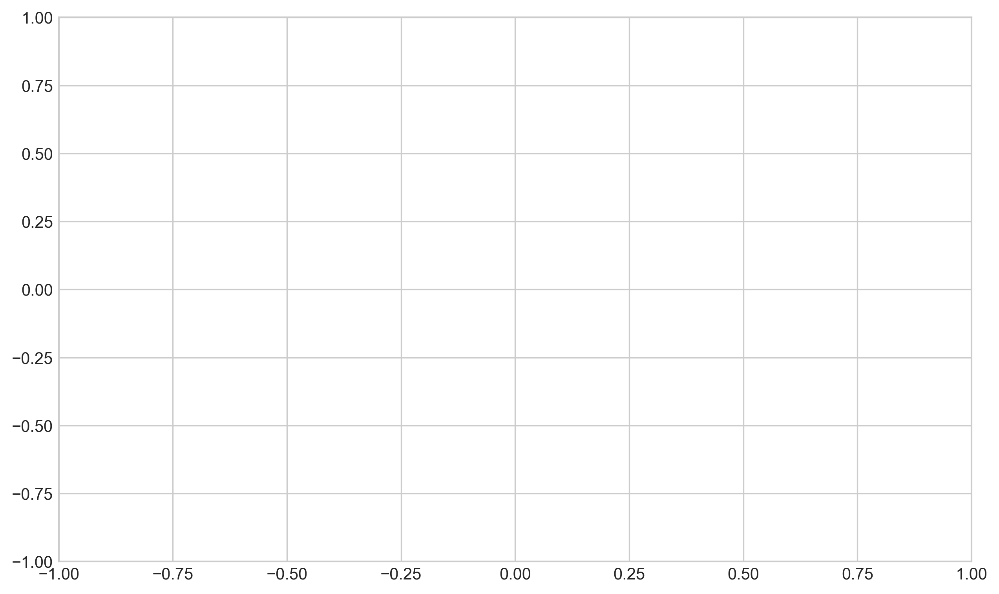

In [19]:
try:
    from pandas.plotting import parallel_coordinates, andrews_curves, radviz
    cols_sel = feature_cols[:10]
    df_vis = df[cols_sel + ['target']].copy()
    df_vis['target_str'] = df_vis['target'].map({0: 'B', 1: 'M'})
    fig, ax = plt.subplots(figsize=(10, 6))
    parallel_coordinates(df_vis.rename(columns={'target_str': 'diagnosis'}), 'diagnosis', cols=cols_sel, ax=ax, color=['#377eb8', '#e41a1c'])
    save_fig(fig, "parallel_coordinates.png")
    fig = plt.figure(figsize=(10, 6))
    andrews_curves(df_vis.rename(columns={'target_str': 'diagnosis'}), 'diagnosis')
    save_fig(plt.gcf(), "andrews_curves.png")
    fig = plt.figure(figsize=(10, 6))
    radviz(df_vis.rename(columns={'target_str': 'diagnosis'}), 'diagnosis', cols=cols_sel)
    save_fig(plt.gcf(), "radviz.png")
except Exception:
    pass

Section 19 — PCA (Scree, Variance, 2D/3D)
Learning Objective: Reduce dimensionality; assess explained variance.
Clinician Prompt: Consider PCA components for visualization vs modeling.

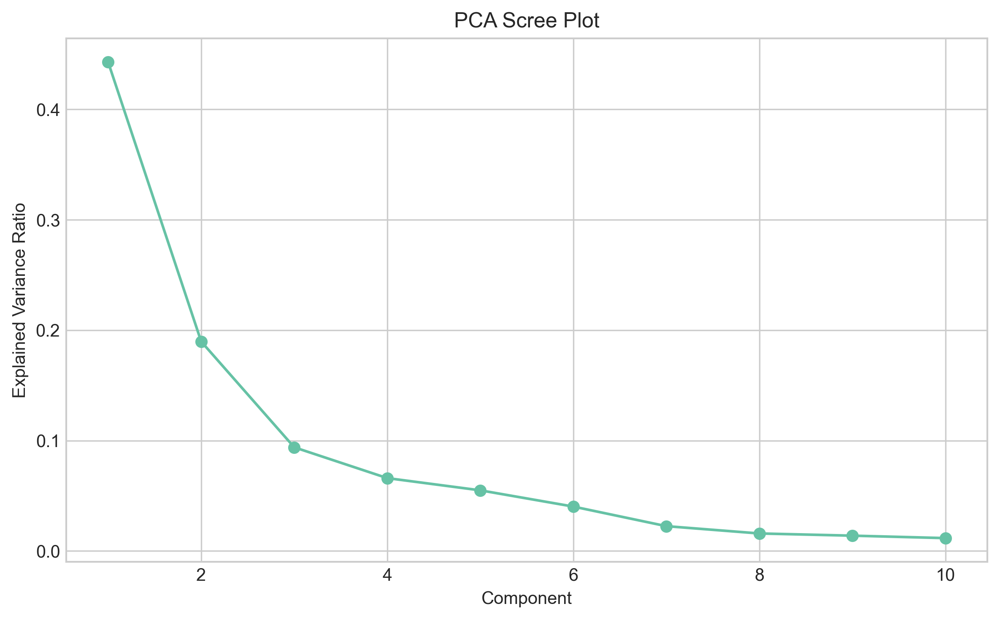

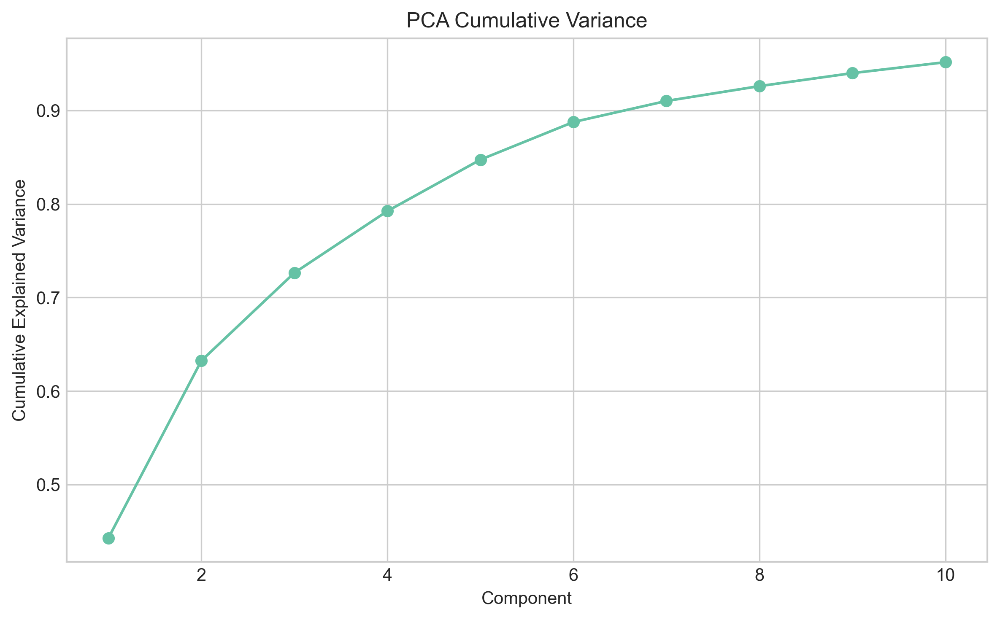

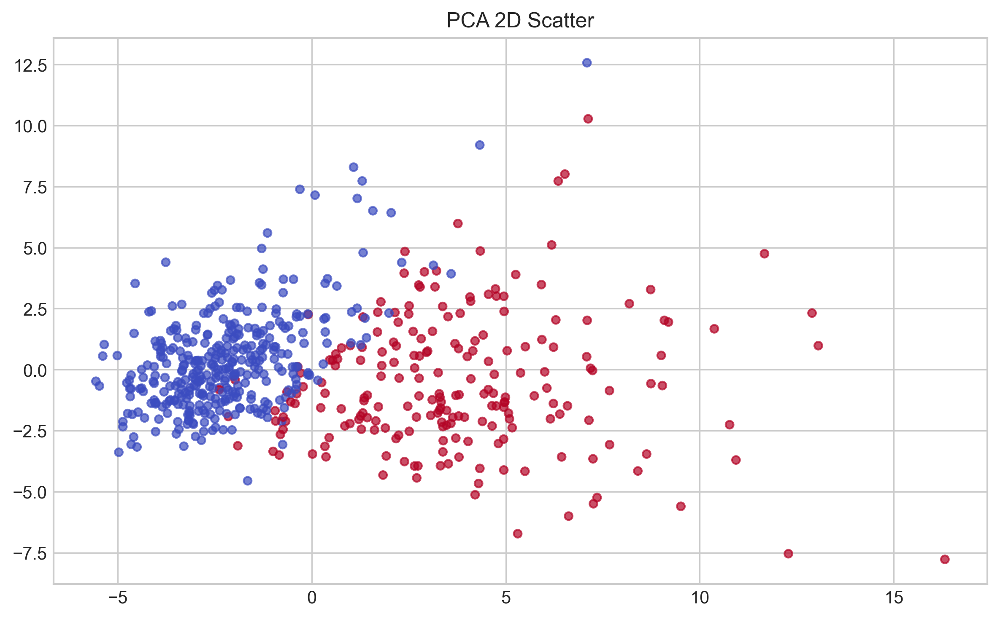

In [20]:
df_pca = df.copy()
X_df = df_pca[feature_cols].copy()
pca_feature_names = X_df.columns
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy="median")
X_imputed = imputer.fit_transform(X_df)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)
pca = PCA(n_components=min(len(feature_cols), 10), random_state=SEED)
X_pca = pca.fit_transform(X_scaled)

evr = pca.explained_variance_ratio_
fig, ax = plt.subplots()
ax.plot(range(1, len(evr)+1), evr, marker='o')
ax.set_title("PCA Scree Plot")
ax.set_xlabel("Component")
ax.set_ylabel("Explained Variance Ratio")
save_fig(fig, "pca_scree.png")

fig, ax = plt.subplots()
ax.plot(range(1, len(evr)+1), np.cumsum(evr), marker='o')
ax.set_title("PCA Cumulative Variance")
ax.set_xlabel("Component")
ax.set_ylabel("Cumulative Explained Variance")
save_fig(fig, "pca_cumulative.png")

if 'target' in df_pca.columns:
    fig, ax = plt.subplots()
    scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], c=df_pca['target'], cmap='coolwarm', s=20, alpha=0.7)
    ax.set_title("PCA 2D Scatter")
    save_fig(fig, "pca_2d_scatter.png")

if PLOTLY_AVAILABLE:
    try:
        fig3d = px.scatter_3d(x=X_pca[:, 0], y=X_pca[:, 1], z=X_pca[:, 2], color=df_pca['target'].map({0:'B',1:'M'}) if 'target' in df_pca.columns else None, title='PCA 3D Scatter')
        if WRITE_PLOTLY_IMAGE:
            fig3d.write_image(os.path.join(DIRS['figures'], 'pca_3d.png'))
        fig3d.write_html(os.path.join(DIRS['figures'], 'pca_3d.html'))
    except Exception:
        pass

Section 20 — Biplot & Component Contributions
Learning Objective: Interpret PCA loadings and feature contributions.
Clinician Prompt: Relate components back to biology.

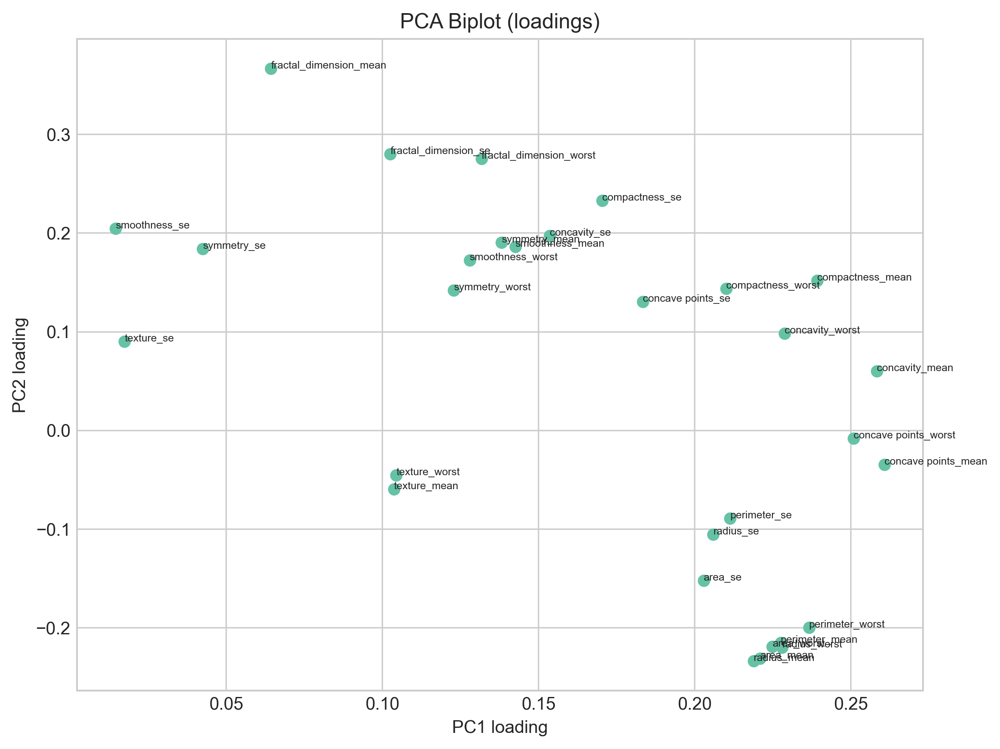

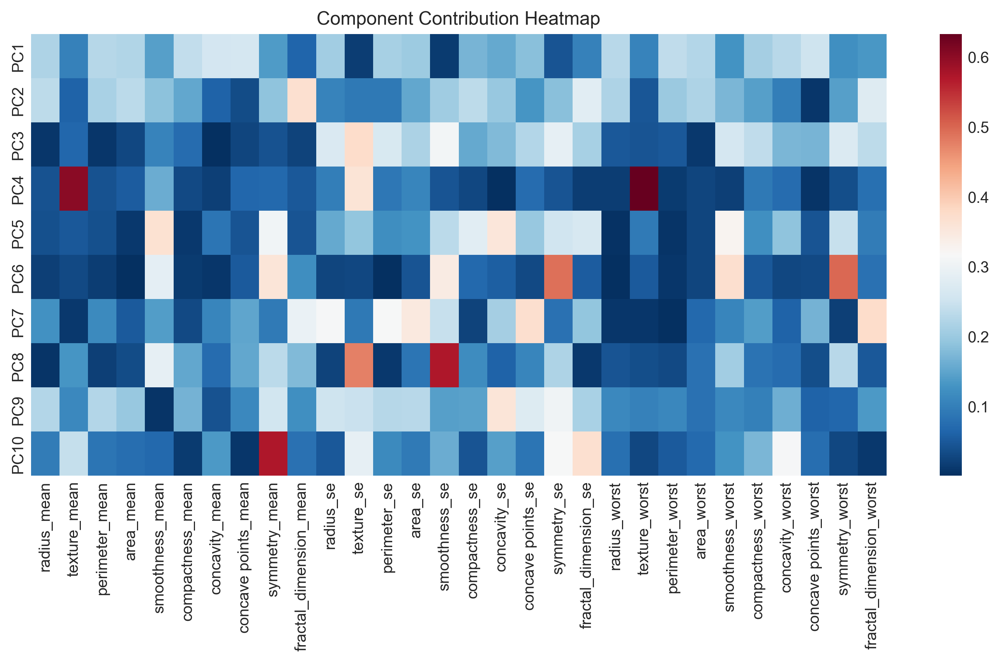

'figures\\pca_component_contrib_heatmap.png'

In [21]:
loadings = pca.components_.T
fig, ax = plt.subplots(figsize=(8, 6))
ax.scatter(loadings[:, 0], loadings[:, 1])
for i, c in enumerate(pca_feature_names[:loadings.shape[0]]):
    ax.text(loadings[i, 0], loadings[i, 1], c, fontsize=6)
ax.set_xlabel('PC1 loading')
ax.set_ylabel('PC2 loading')
ax.set_title('PCA Biplot (loadings)')
save_fig(fig, "pca_biplot_loadings.png")

fig, ax = plt.subplots(figsize=(10, 6))
sns.heatmap(np.abs(pca.components_), cmap='RdBu_r', yticklabels=[f"PC{i+1}" for i in range(pca.n_components_)], xticklabels=list(pca_feature_names[:loadings.shape[0]]), ax=ax)
ax.set_title("Component Contribution Heatmap")
save_fig(fig, "pca_component_contrib_heatmap.png")

Section 21 — Univariate Feature Selection (SelectKBest)
Learning Objective: Rank features by ANOVA F and p-values.
Clinician Prompt: Prioritize interpretable strong predictors.

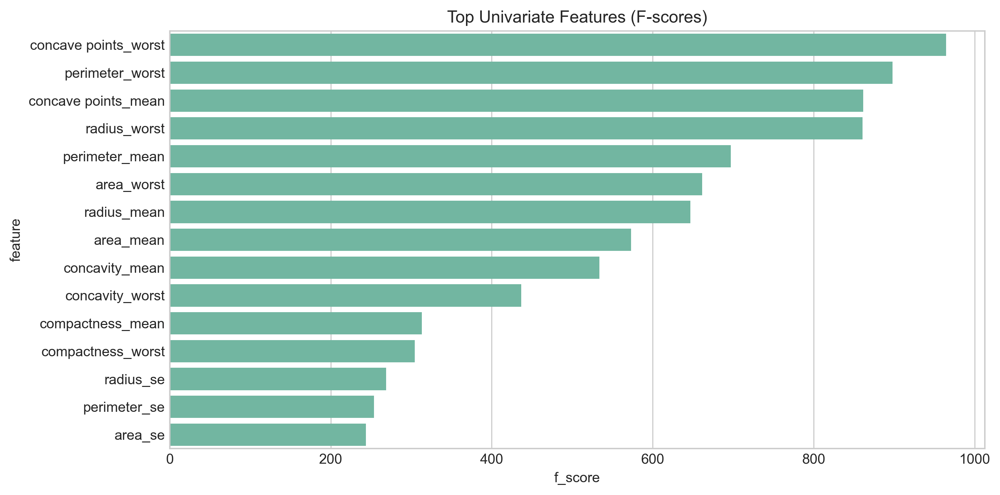

In [22]:
if 'target' in df.columns:
    skb = SelectKBest(score_func=f_classif, k='all')
    skb.fit(X_scaled, df['target'])
    f_scores = skb.scores_
    pvals = skb.pvalues_
    sel_df = pd.DataFrame({'feature': list(pca_feature_names[:len(f_scores)]), 'f_score': f_scores, 'p_value': pvals}).sort_values('f_score', ascending=False)
    sel_df.to_csv(os.path.join(DIRS['reports'], 'selectkbest_results.csv'), index=False)
    fig, ax = plt.subplots(figsize=(10, 5))
    sns.barplot(data=sel_df.head(15), x='f_score', y='feature', ax=ax, orient='h', color="#66c2a5")
    ax.set_title("Top Univariate Features (F-scores)")
    save_fig(fig, "selectkbest_top15.png")

Section 22 — Model-Based Importance & Permutation
Learning Objective: Compare feature importance strategies.
Clinician Prompt: Validate stability of important features.

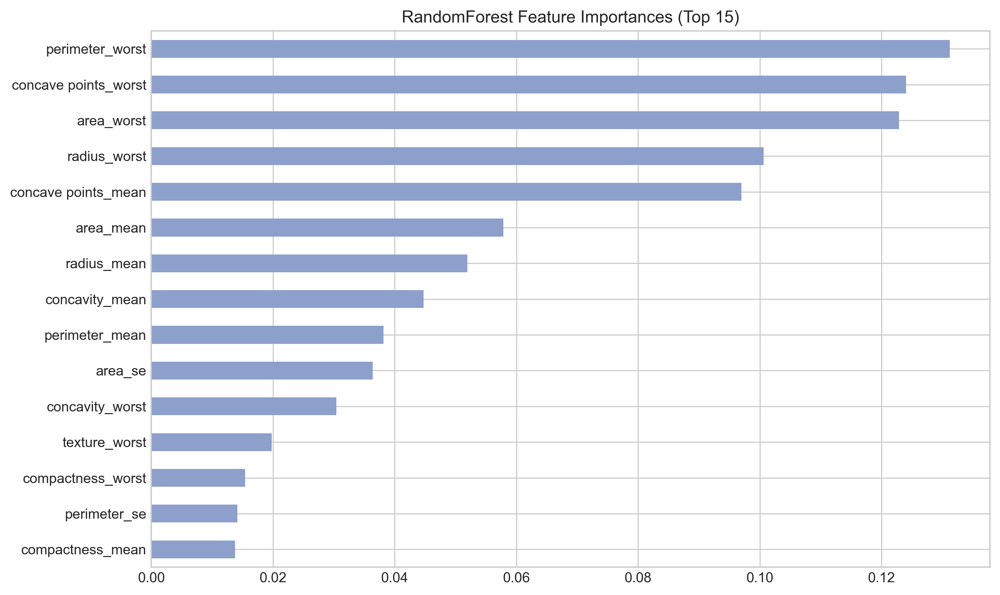

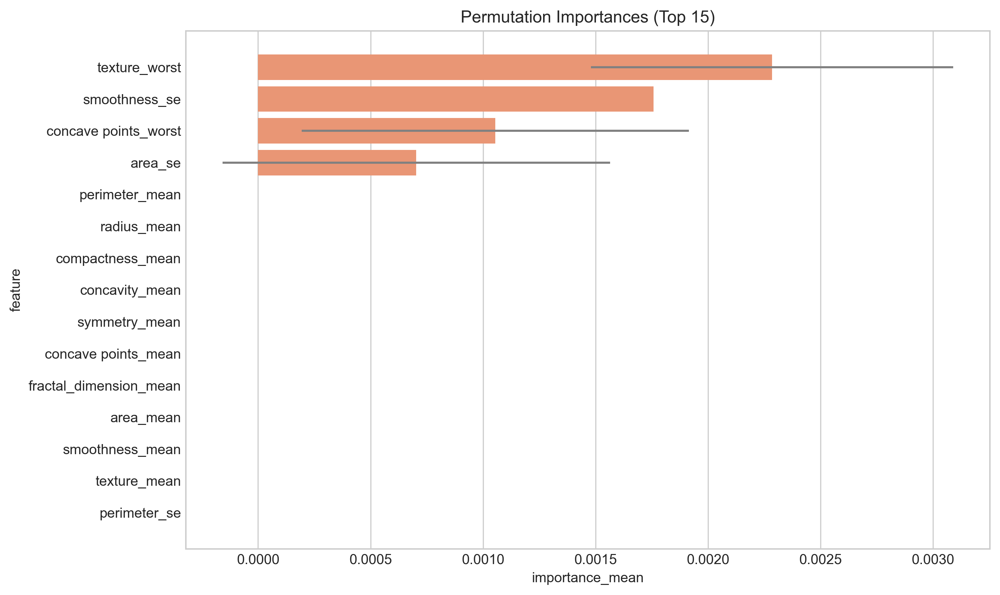

In [23]:
rf = RandomForestClassifier(n_estimators=300, random_state=SEED)
rf.fit(X_scaled, df['target'])
imp = pd.Series(rf.feature_importances_, index=list(pca_feature_names[:len(rf.feature_importances_)])).sort_values(ascending=True)
fig, ax = plt.subplots(figsize=(10, 6))
imp.tail(15).plot(kind='barh', ax=ax, color="#8da0cb")
ax.set_title("RandomForest Feature Importances (Top 15)")
save_fig(fig, "rf_importances_top15.png")

perm = permutation_importance(rf, X_scaled, df['target'], n_repeats=10, random_state=SEED)
perm_df = pd.DataFrame({'feature': list(pca_feature_names[:len(perm.importances_mean)]), 'importance_mean': perm.importances_mean, 'importance_std': perm.importances_std}).sort_values('importance_mean', ascending=False)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(data=perm_df.head(15), x='importance_mean', y='feature', ax=ax, color="#fc8d62")
ax.errorbar(perm_df.head(15)['importance_mean'], range(15), xerr=perm_df.head(15)['importance_std'], fmt='none', ecolor='gray')
ax.set_title("Permutation Importances (Top 15)")
save_fig(fig, "perm_importances_top15.png")

comp = sel_df.merge(perm_df, on='feature', how='inner') if 'sel_df' in globals() else perm_df.copy()
comp.to_csv(os.path.join(DIRS['reports'], 'feature_importance_comparison.csv'), index=False)

Section 23 — SHAP Interpretability
Learning Objective: Explain model predictions via SHAP values.
Clinician Prompt: Review top drivers of malignancy predictions.

In [24]:
if RUN_SHAP:
    if SHAP_AVAILABLE:
        try:
            explainer = shap.TreeExplainer(rf)
            shap_values = explainer.shap_values(X_scaled)
            # Summary plots
            shap.summary_plot(shap_values[1], features=X_scaled, feature_names=feature_cols, show=False)
            plt.savefig(os.path.join(DIRS['figures'], 'shap_summary_beeswarm.png'), dpi=300, bbox_inches='tight')
            plt.close()
            shap.summary_plot(shap_values[1], features=X_scaled, feature_names=feature_cols, plot_type='bar', show=False)
            plt.savefig(os.path.join(DIRS['figures'], 'shap_summary_bar.png'), dpi=300, bbox_inches='tight')
            plt.close()
            np.save(os.path.join(DIRS['artifacts'], 'shap_values_class1.npy'), shap_values[1])
        except Exception as e:
            print(f"SHAP ran into an issue: {e}. Falling back to sample subset.")
            idx = np.random.choice(len(X_scaled), size=min(200, len(X_scaled)), replace=False)
            try:
                shap.summary_plot(shap_values[1][idx], features=X_scaled[idx], feature_names=feature_cols, show=False)
                plt.savefig(os.path.join(DIRS['figures'], 'shap_summary_beeswarm_subset.png'), dpi=300, bbox_inches='tight')
                plt.close()
            except Exception:
                pass
    else:
        safe_install_msg('shap', "pip install shap")

Optional library 'shap' not available. pip install shap


Section 24 — Correlation Network Graph
Learning Objective: Visualize strongly linked features as a graph.
Clinician Prompt: Consider pruning highly redundant nodes.

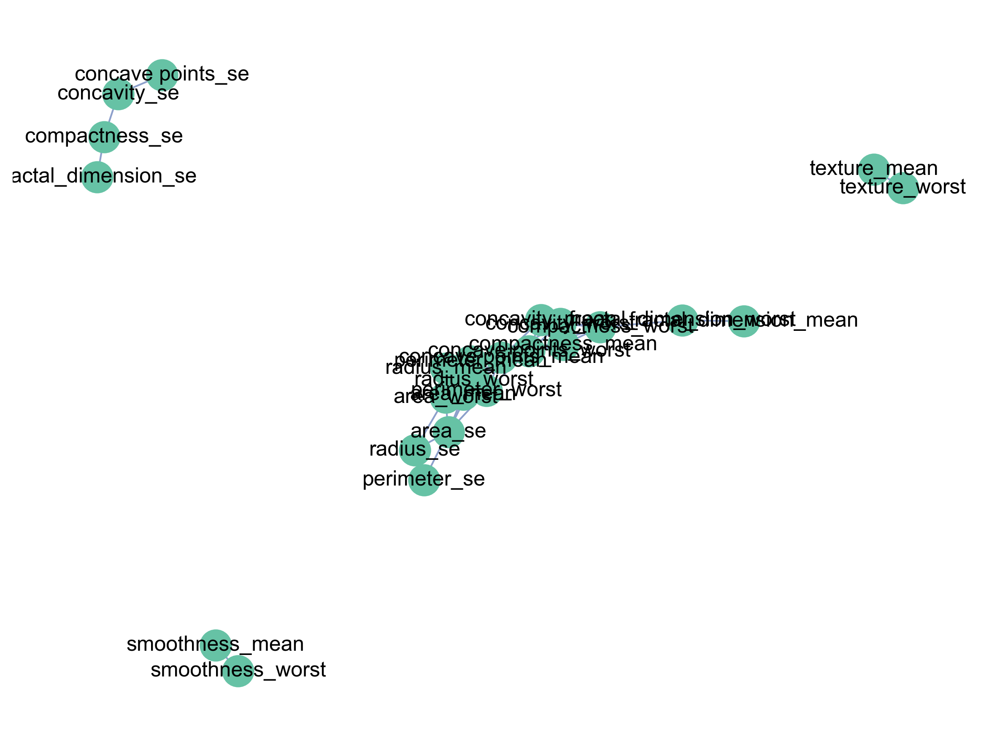

In [25]:
if NX_AVAILABLE:
    G = nx.Graph()
    threshold = 0.75
    for a, b, r in pairs:
        if abs(r) >= threshold:
            G.add_edge(a, b, weight=r)
    pos = nx.spring_layout(G, seed=SEED)
    fig, ax = plt.subplots(figsize=(8, 6))
    nx.draw(G, pos, with_labels=True, node_color="#66c2a5", edge_color="#8da0cb", ax=ax)
    save_fig(fig, "corr_network.png")
else:
    safe_install_msg('networkx', "pip install networkx")

Section 25 — Feature Subset Selection (RFE)
Learning Objective: Select optimal subset and quantify performance delta.
Clinician Prompt: Balance performance with interpretability and cost.

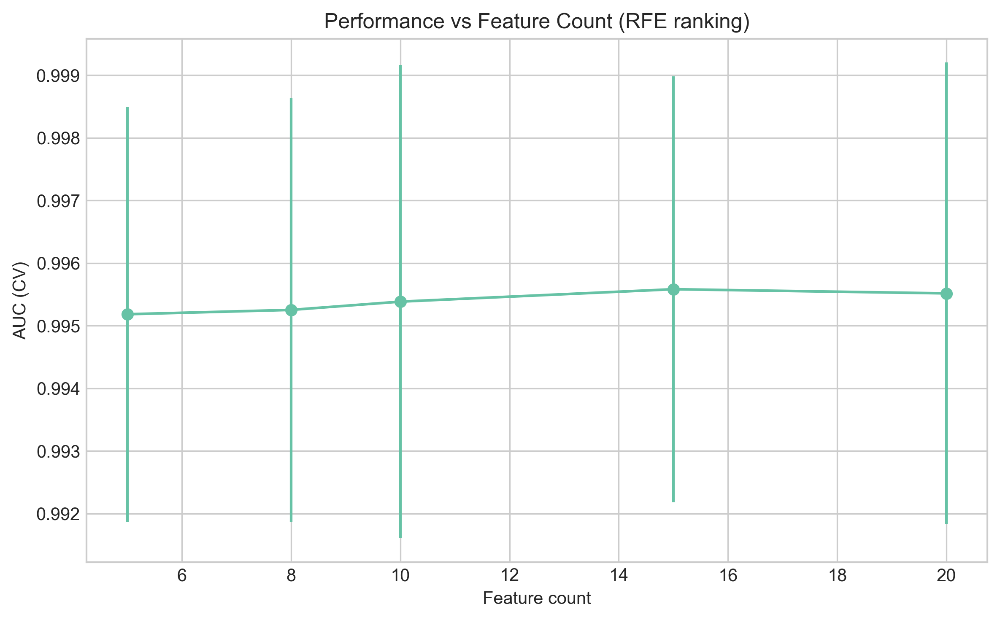

In [26]:
if 'target' in df.columns:
    base_est = LogisticRegression(max_iter=500, solver='liblinear', random_state=SEED)
    rfe = RFE(base_est, n_features_to_select=10)
    rfe.fit(X_scaled, df['target'])
    selected = [f for f, keep in zip(feature_cols, rfe.support_) if keep]
    perf_rows = []
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)
    for k in [5, 8, 10, 15, 20]:
        mask = rfe.ranking_ <= k
        Xk = X_scaled[:, mask]
        scores = cross_val_score(base_est, Xk, df['target'], cv=skf, scoring='roc_auc')
        perf_rows.append({'features': int(k), 'auc_mean': scores.mean(), 'auc_std': scores.std()})
    perf_df = pd.DataFrame(perf_rows)
    perf_df.to_csv(os.path.join(DIRS['reports'], 'feature_subset_performance.csv'), index=False)
    fig, ax = plt.subplots()
    ax.errorbar(perf_df['features'], perf_df['auc_mean'], yerr=perf_df['auc_std'], fmt='-o')
    ax.set_title("Performance vs Feature Count (RFE ranking)")
    ax.set_xlabel("Feature count")
    ax.set_ylabel("AUC (CV)")
    save_fig(fig, "feature_subset_auc.png")

Section 26 — Train/Test Split & Class Preservation
Learning Objective: Create stratified splits and verify class balance.
Clinician Prompt: Ensure malignant cases represented in both sets.

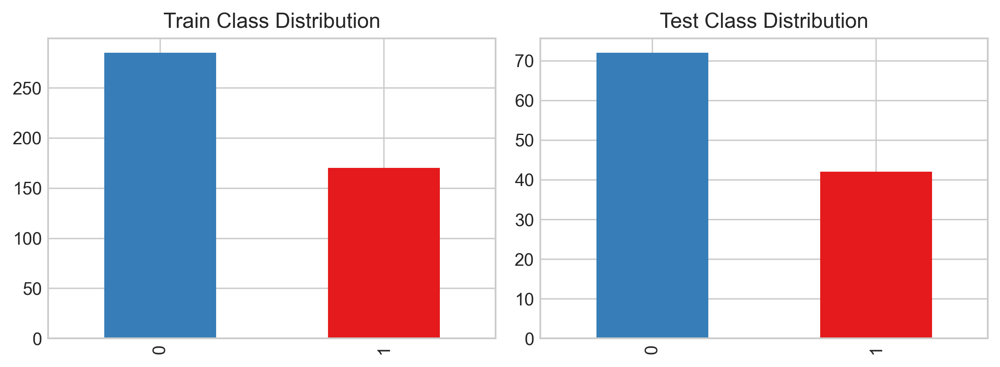

In [27]:
if 'target' in df.columns:
    X = df[feature_cols].values
    y = df['target'].values
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=SEED)
    fig, axes = plt.subplots(1, 2, figsize=(8, 3))
    pd.Series(y_train).value_counts().plot(kind='bar', ax=axes[0], color=["#377eb8", "#e41a1c"])
    axes[0].set_title("Train Class Distribution")
    pd.Series(y_test).value_counts().plot(kind='bar', ax=axes[1], color=["#377eb8", "#e41a1c"])
    axes[1].set_title("Test Class Distribution")
    save_fig(fig, "split_class_balance.png")

Section 27 — Baseline & Multi-Model ROC/PR
Learning Objective: Train baseline LR and compare models via ROC/PR.
Clinician Prompt: Evaluate trade-offs favoring recall for malignancy.

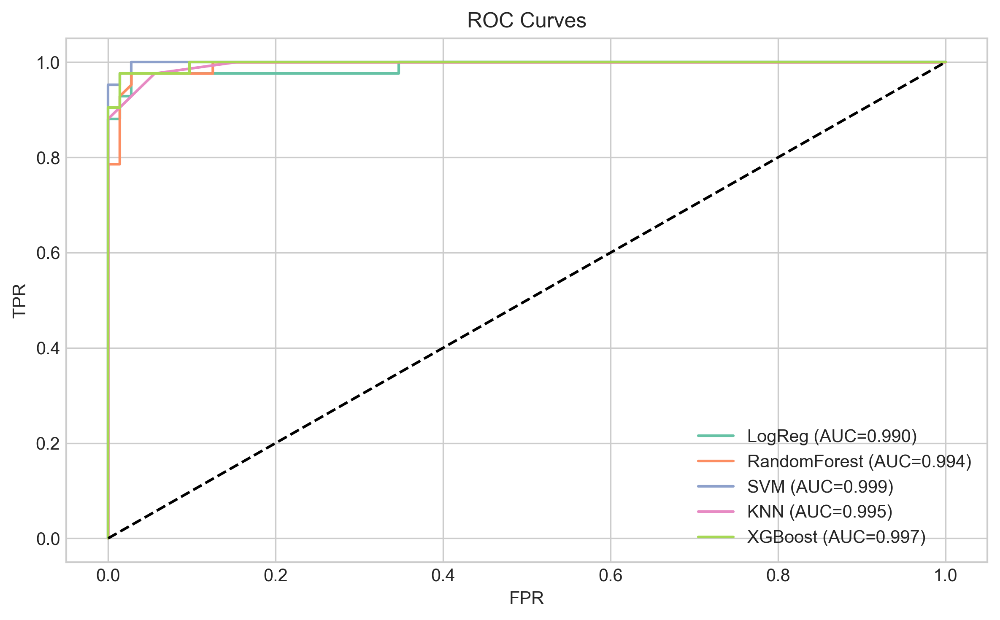

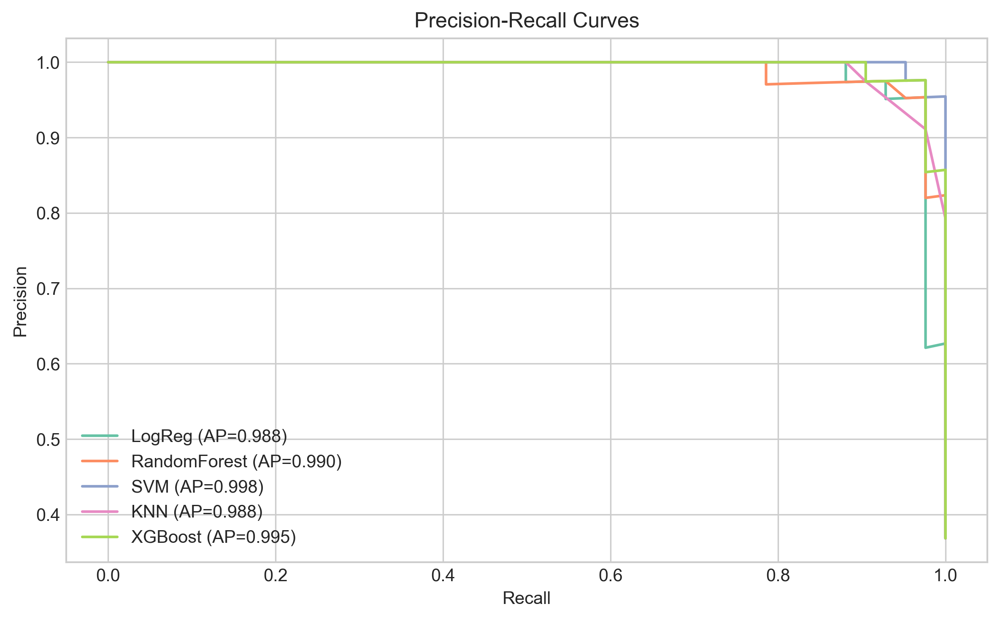

Saved model comparison to: reports\model_comparison.csv


In [28]:
models = []
from sklearn.impute import SimpleImputer
models.append(("LogReg", Pipeline([('imputer', SimpleImputer(strategy='median')), ('scaler', StandardScaler()), ('clf', LogisticRegression(max_iter=500, solver='liblinear', random_state=SEED))])))
models.append(("RandomForest", Pipeline([('imputer', SimpleImputer(strategy='median')), ('clf', RandomForestClassifier(n_estimators=500, random_state=SEED, class_weight='balanced'))])))
models.append(("SVM", Pipeline([('imputer', SimpleImputer(strategy='median')), ('scaler', StandardScaler()), ('clf', SVC(probability=True, kernel='rbf', C=1.0, gamma='scale', random_state=SEED))])))
models.append(("KNN", Pipeline([('imputer', SimpleImputer(strategy='median')), ('scaler', StandardScaler()), ('clf', KNeighborsClassifier(n_neighbors=7))])))
if XGB_AVAILABLE:
    models.append(("XGBoost", xgb.XGBClassifier(n_estimators=400, learning_rate=0.05, max_depth=4, subsample=0.9, colsample_bytree=0.9, random_state=SEED, reg_lambda=1.0)))

perf_table = []
fig_roc, ax_roc = plt.subplots()
fig_pr, ax_pr = plt.subplots()

for name, mdl in models:
    mdl.fit(X_train, y_train)
    y_prob = mdl.predict_proba(X_test)[:, 1]
    y_pred = mdl.predict(X_test)
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    ax_roc.plot(fpr, tpr, label=f"{name} (AUC={auc(fpr, tpr):.3f})")
    prec, rec, _ = precision_recall_curve(y_test, y_prob)
    ap = average_precision_score(y_test, y_prob)
    ax_pr.plot(rec, prec, label=f"{name} (AP={ap:.3f})")
    perf_table.append(summarize_model_performance(name, y_test, y_prob, y_pred))

ax_roc.plot([0, 1], [0, 1], 'k--')
ax_roc.set_title("ROC Curves")
ax_roc.set_xlabel("FPR")
ax_roc.set_ylabel("TPR")
ax_roc.legend()
save_fig(fig_roc, "roc_multi.png")

ax_pr.set_title("Precision-Recall Curves")
ax_pr.set_xlabel("Recall")
ax_pr.set_ylabel("Precision")
ax_pr.legend()
save_fig(fig_pr, "pr_multi.png")

perf_df = pd.DataFrame(perf_table)
perf_path = os.path.join(DIRS['reports'], 'model_comparison.csv')
perf_df.to_csv(perf_path, index=False)
print(f"Saved model comparison to: {perf_path}")

Section 28 — Threshold Optimization
Learning Objective: Choose operating threshold maximizing F1/Recall.
Clinician Prompt: Prefer high recall to minimize false negatives.

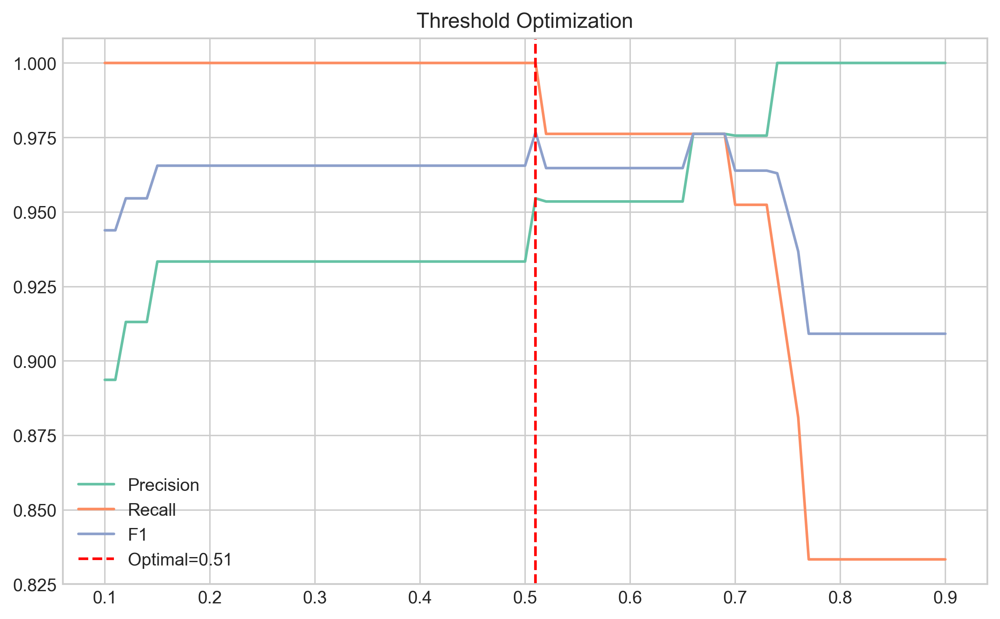

'figures\\threshold_optimization.png'

In [29]:
best_model_name = perf_df.sort_values('auc', ascending=False).iloc[0]['model']
best_model = [m for m in models if m[0] == best_model_name][0][1]
probs = best_model.predict_proba(X_test)[:, 1]
thresholds = np.linspace(0.1, 0.9, 81)
metrics = []
for t in thresholds:
    preds = (probs >= t).astype(int)
    metrics.append({
        'threshold': t,
        'precision': precision_score(y_test, preds),
        'recall': recall_score(y_test, preds),
        'f1': f1_score(y_test, preds)
    })
met_df = pd.DataFrame(metrics)
fig, ax = plt.subplots()
ax.plot(met_df['threshold'], met_df['precision'], label='Precision')
ax.plot(met_df['threshold'], met_df['recall'], label='Recall')
ax.plot(met_df['threshold'], met_df['f1'], label='F1')
opt_t = met_df.iloc[met_df['f1'].idxmax()]['threshold']
ax.axvline(opt_t, color='red', linestyle='--', label=f'Optimal={opt_t:.2f}')
ax.set_title("Threshold Optimization")
ax.legend()
save_fig(fig, "threshold_optimization.png")

Section 29 — Hyperparameter Tuning & Learning/Validation Curves
Learning Objective: Optimize RF/SVM; visualize learning dynamics.
Clinician Prompt: Check for over/underfitting.

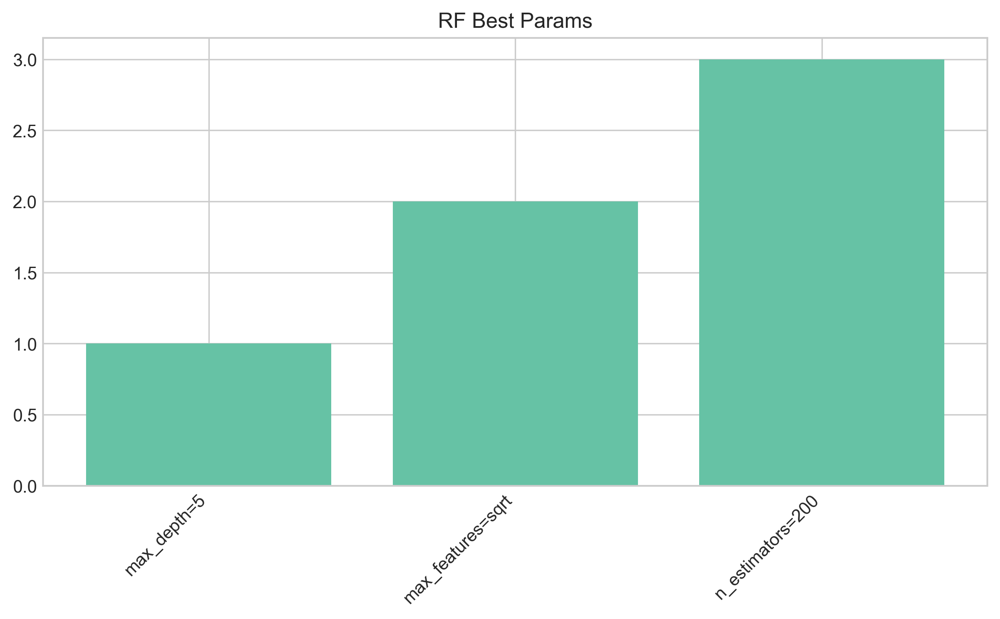

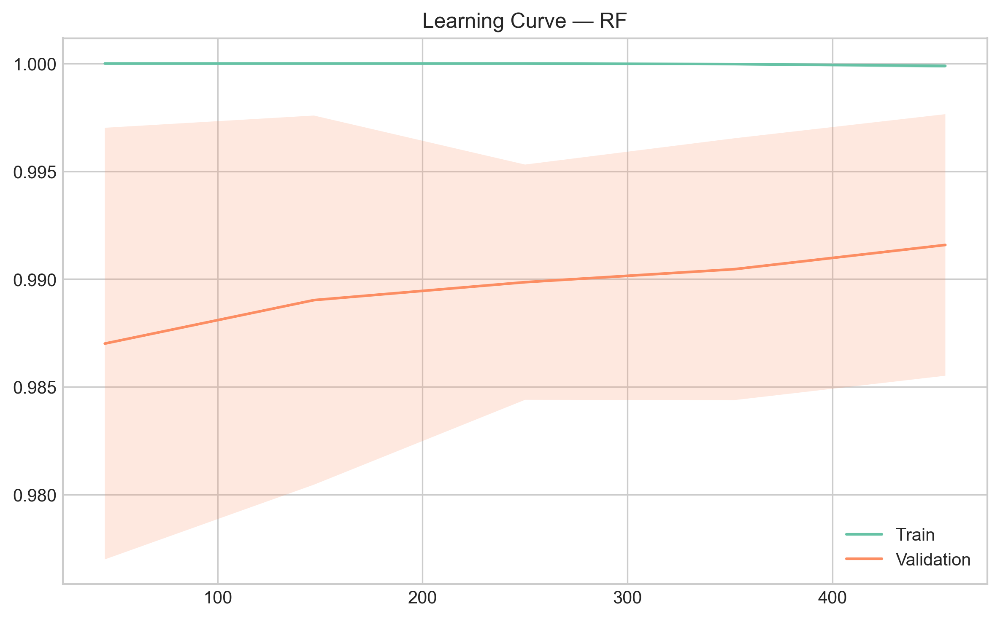

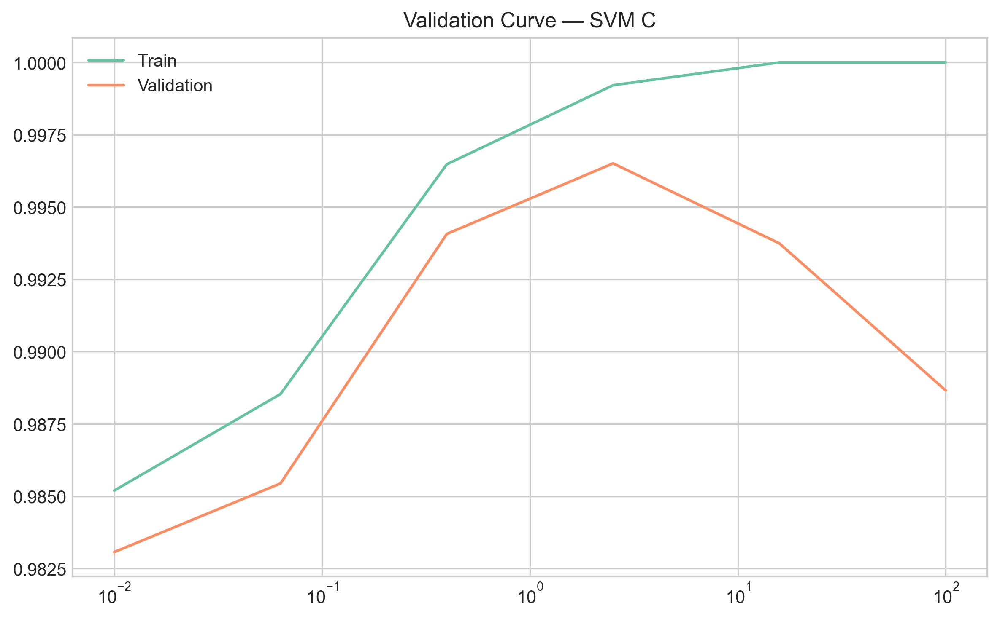

'figures\\validation_curve_svm_C.png'

In [30]:
# Grid/Random Search for RF
rf_grid = {
    'n_estimators': [200, 400, 600],
    'max_depth': [None, 5, 10],
    'max_features': ['sqrt', 0.5, 1.0]
}
rf_cv = GridSearchCV(RandomForestClassifier(random_state=SEED, class_weight='balanced'), rf_grid, cv=3, scoring='roc_auc', n_jobs=-1)
rf_cv.fit(X_train, y_train)

rf_best = rf_cv.best_estimator_
rf_heat = pd.DataFrame(rf_cv.cv_results_)
rf_heat.to_csv(os.path.join(DIRS['reports'], 'rf_gridsearch_results.csv'), index=False)

fig, ax = plt.subplots()
ax.bar(range(len(rf_cv.best_params_)), list(range(1, len(rf_cv.best_params_)+1)))
ax.set_xticks(range(len(rf_cv.best_params_)))
ax.set_xticklabels([f"{k}={v}" for k, v in rf_cv.best_params_.items()], rotation=45, ha='right')
ax.set_title("RF Best Params")
save_fig(fig, "rf_best_params.png")

# Learning curve (best RF)
train_sizes_lc, train_scores_lc, val_scores_lc = learning_curve(rf_best, X, y, cv=5, scoring='roc_auc', n_jobs=-1)
fig, ax = plt.subplots()
ax.plot(train_sizes_lc, train_scores_lc.mean(axis=1), label='Train')
ax.plot(train_sizes_lc, val_scores_lc.mean(axis=1), label='Validation')
ax.fill_between(train_sizes_lc, train_scores_lc.mean(axis=1)-train_scores_lc.std(axis=1), train_scores_lc.mean(axis=1)+train_scores_lc.std(axis=1), alpha=0.2)
ax.fill_between(train_sizes_lc, val_scores_lc.mean(axis=1)-val_scores_lc.std(axis=1), val_scores_lc.mean(axis=1)+val_scores_lc.std(axis=1), alpha=0.2)
ax.set_title("Learning Curve — RF")
ax.legend()
save_fig(fig, "learning_curve_rf.png")

# Validation curve for SVM C
svm = SVC(probability=True, kernel='rbf', gamma='scale', random_state=SEED)
param_range = np.logspace(-2, 2, 6)
train_scores_vc, val_scores_vc = validation_curve(svm, X_scaled, y, param_name='C', param_range=param_range, cv=5, scoring='roc_auc', n_jobs=-1)
fig, ax = plt.subplots()
ax.semilogx(param_range, train_scores_vc.mean(axis=1), label='Train')
ax.semilogx(param_range, val_scores_vc.mean(axis=1), label='Validation')
ax.set_title("Validation Curve — SVM C")
ax.legend()
save_fig(fig, "validation_curve_svm_C.png")

Section 30 — Calibration, Error Analysis, Clustering & Dashboards, Deployment
Learning Objective: Final calibration, error insights, clustering, dashboards, and export artifacts.
Clinician Prompt: Interpret false negatives vs false positives; review deployment pathway.

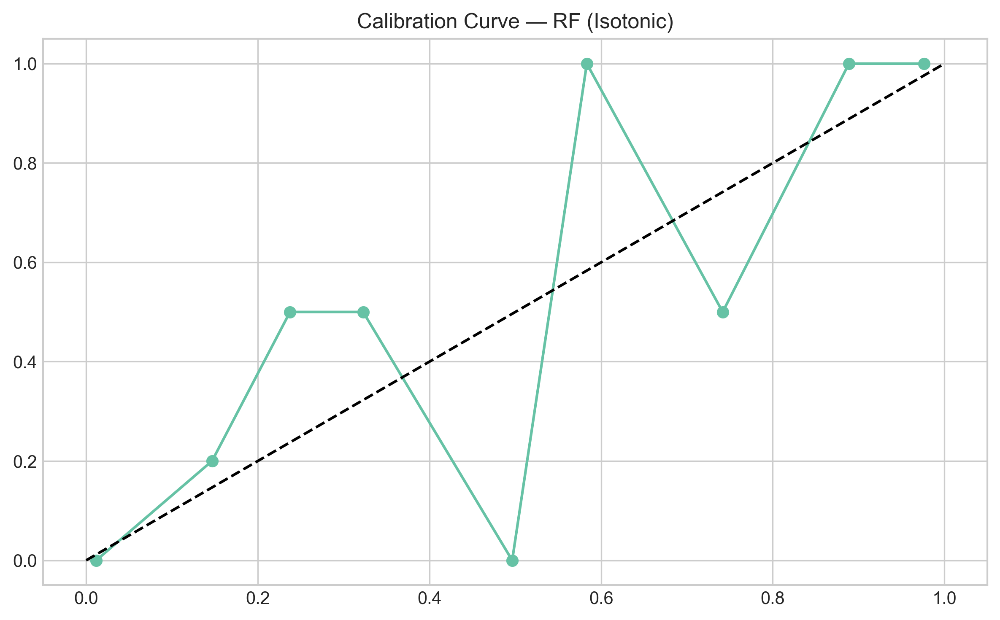

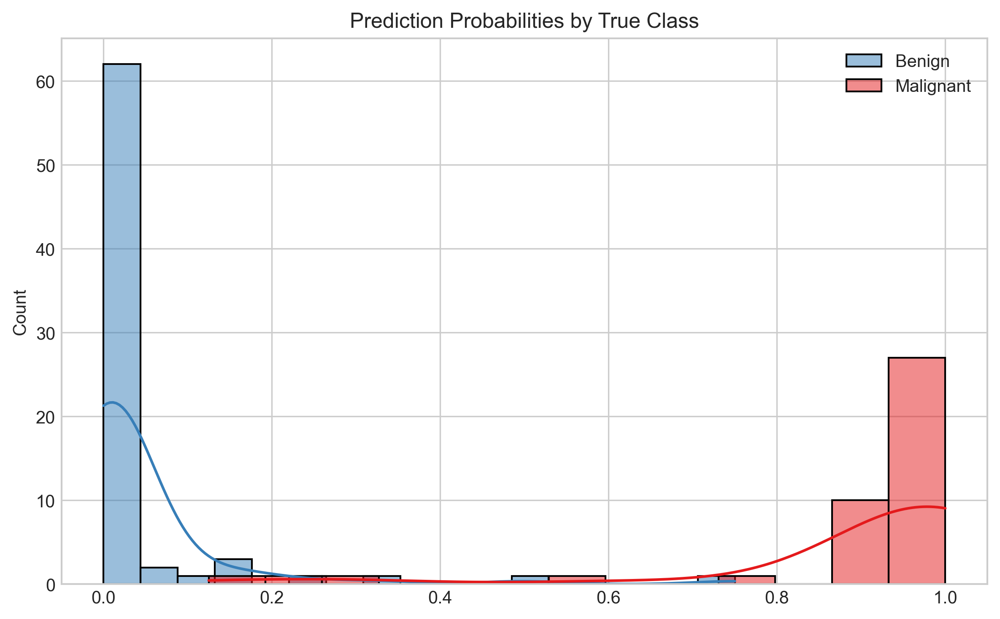

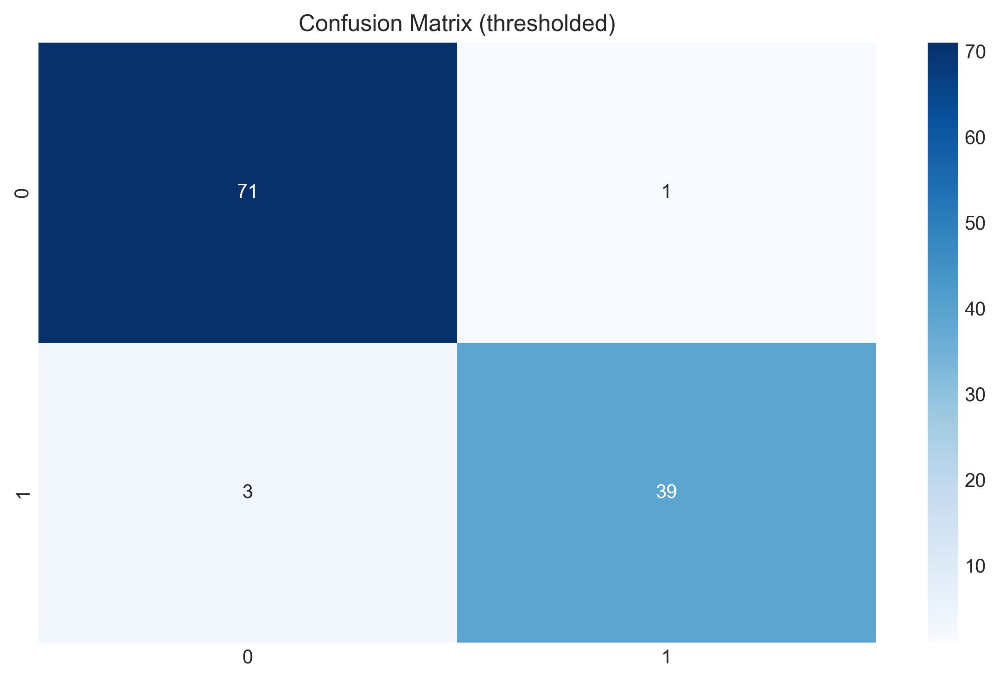

Saved misclassified samples: reports\misclassified_samples.csv


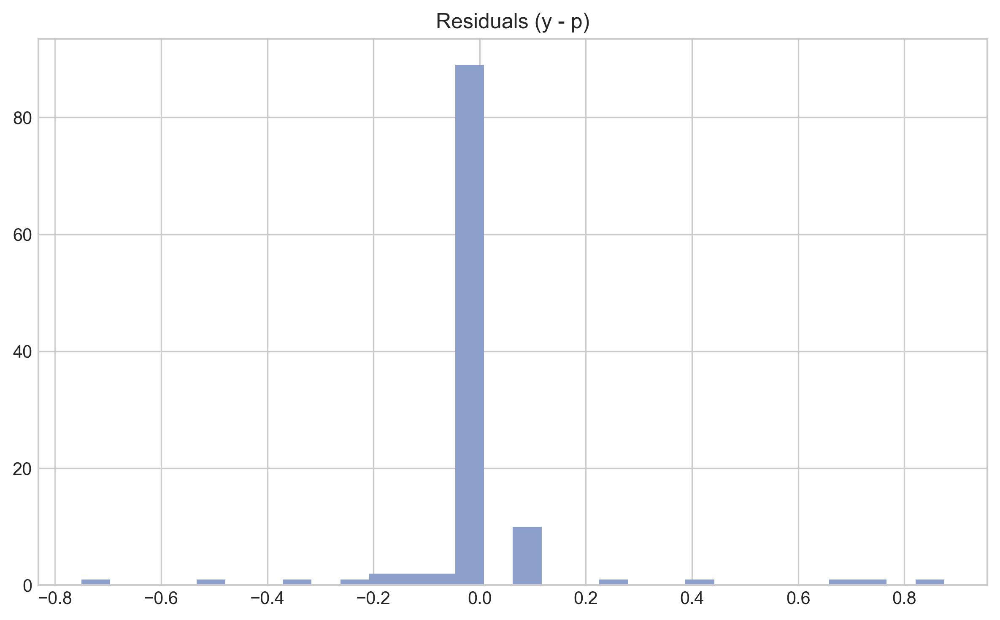

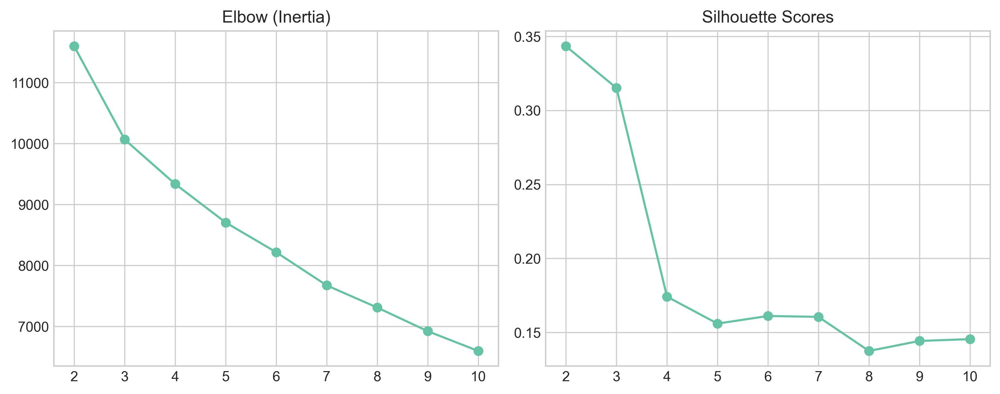

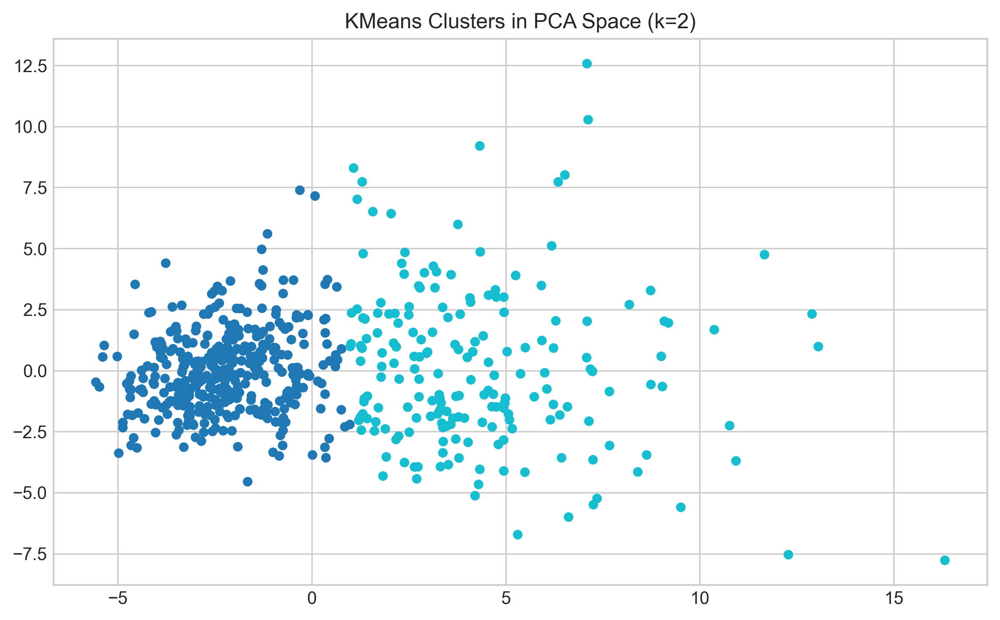

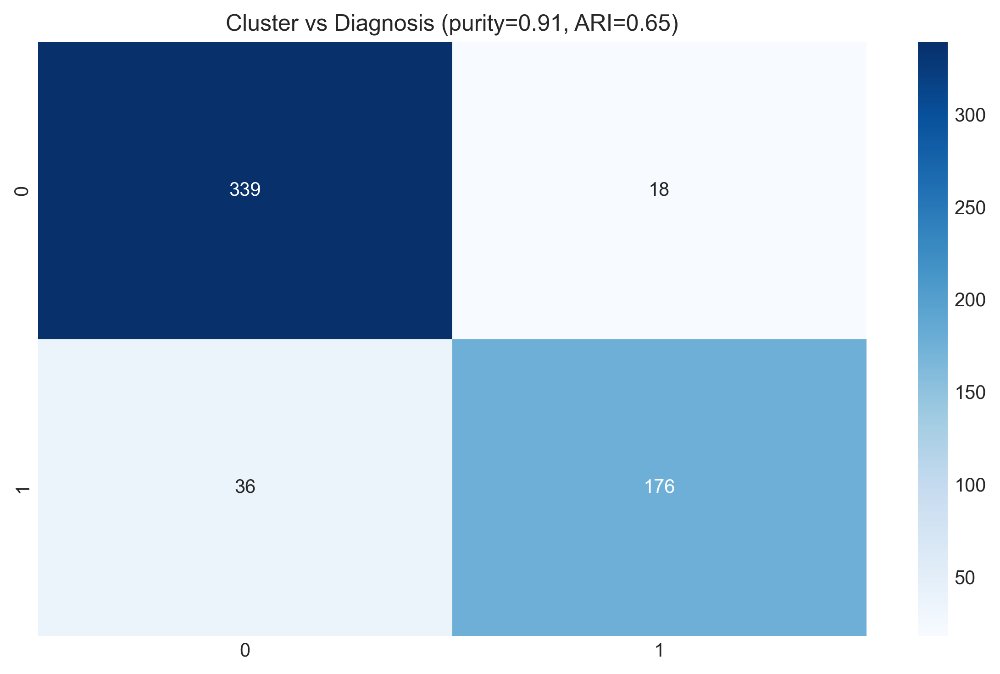

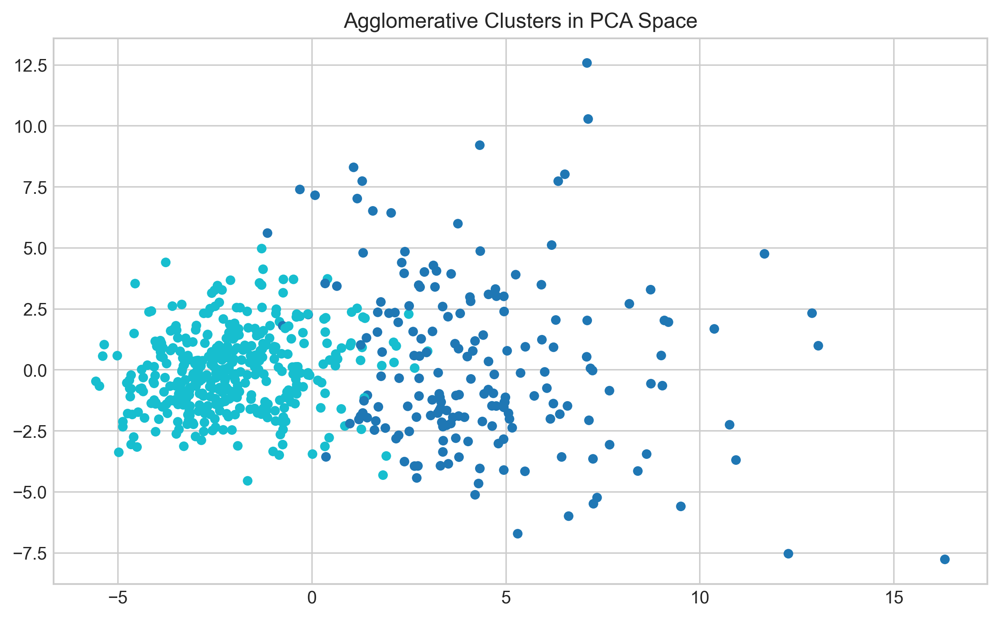

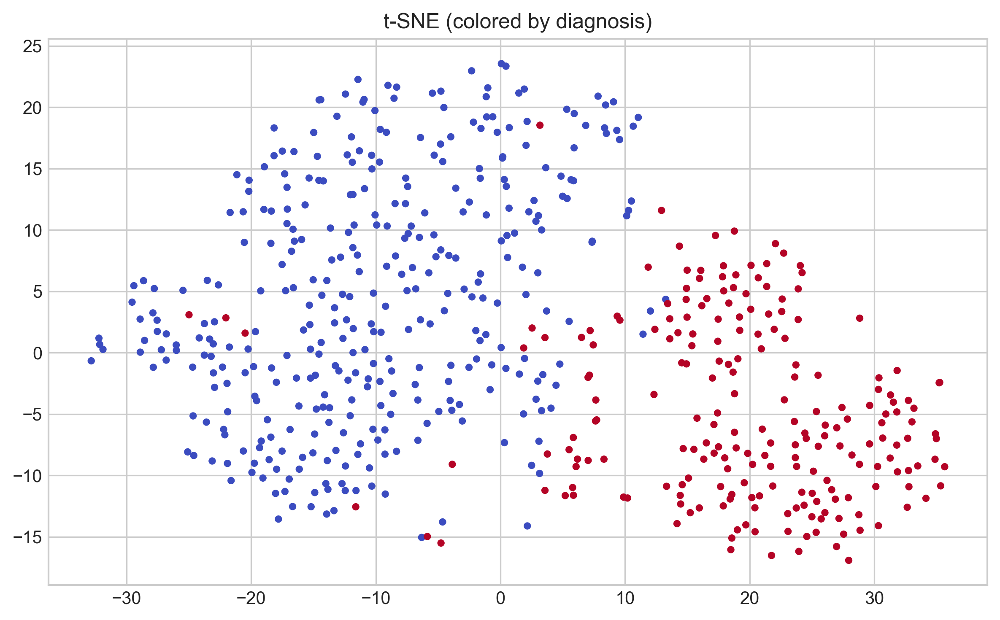

Optional library 'umap-learn' not available. pip install umap-learn


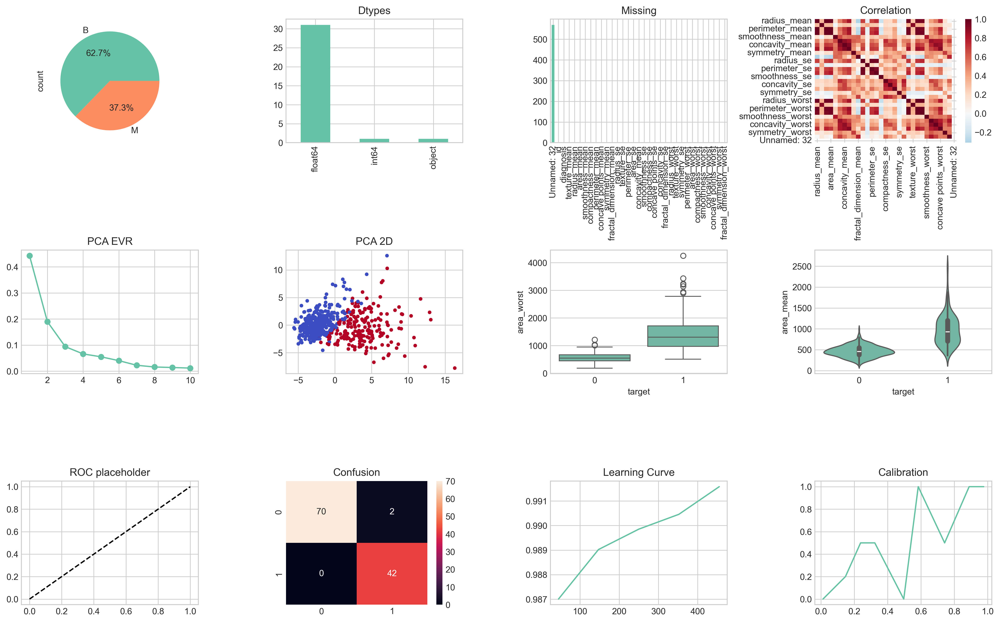

Sample prediction: prob=0.235, pred=0


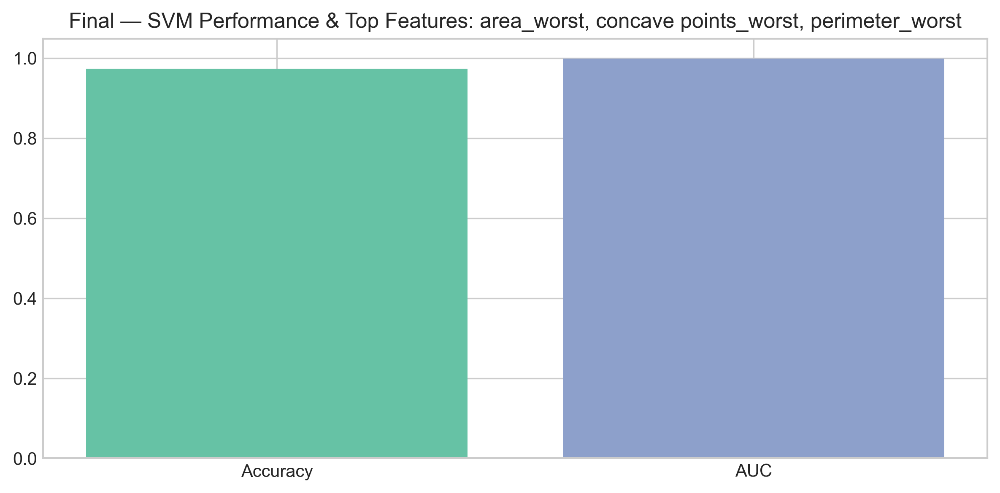

Breast_cancer_wisconsin_analytics completed. See figures/, reports/, artifacts/ for outputs.


In [31]:
# Calibration
cal_rf = CalibratedClassifierCV(rf_best, method='isotonic', cv=3)
cal_rf.fit(X_train, y_train)
y_prob_cal = cal_rf.predict_proba(X_test)[:, 1]
prob_true, prob_pred = calibration_curve(y_test, y_prob_cal, n_bins=10)
fig, ax = plt.subplots()
ax.plot(prob_pred, prob_true, marker='o')
ax.plot([0, 1], [0, 1], 'k--')
ax.set_title("Calibration Curve — RF (Isotonic)")
save_fig(fig, "calibration_curve_rf.png")

# Prediction probability distributions
fig, ax = plt.subplots()
sns.histplot(y_prob_cal[y_test==0], color='#377eb8', label='Benign', kde=True, ax=ax)
sns.histplot(y_prob_cal[y_test==1], color='#e41a1c', label='Malignant', kde=True, ax=ax)
ax.legend()
ax.set_title("Prediction Probabilities by True Class")
save_fig(fig, "prediction_probs_by_class.png")

# Confusion matrix
y_pred_cal = (y_prob_cal >= opt_t).astype(int)
cm = confusion_matrix(y_test, y_pred_cal)
fig, ax = plt.subplots()
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax)
ax.set_title("Confusion Matrix (thresholded)")
save_fig(fig, "confusion_matrix_thresholded.png")

# Error analysis
mis_idx = np.where(y_test != y_pred_cal)[0]
mis_samples = pd.DataFrame(X_test[mis_idx], columns=feature_cols)
mis_samples['true'] = y_test[mis_idx]
mis_samples['pred'] = y_pred_cal[mis_idx]
mis_path = os.path.join(DIRS['reports'], 'misclassified_samples.csv')
mis_samples.to_csv(mis_path, index=False)
print(f"Saved misclassified samples: {mis_path}")

# Simple residual diagnostic (probability residuals)
fig, ax = plt.subplots()
resid = y_test - y_prob_cal
ax.hist(resid, bins=30, color="#8da0cb")
ax.set_title("Residuals (y - p)")
save_fig(fig, "residuals_hist.png")

# Statistical tests example: t-test / Mann-Whitney for top feature
topf = top_feats[0] if 'top_feats' in globals() and len(top_feats)>0 else feature_cols[0]
x = df.loc[df['target']==1, topf]
y_b = df.loc[df['target']==0, topf]
normal_x = stats.shapiro(x.sample(min(100, len(x)), random_state=SEED)).pvalue > 0.05
normal_y = stats.shapiro(y_b.sample(min(100, len(y_b)), random_state=SEED)).pvalue > 0.05
rows = []
if normal_x and normal_y:
    stat, p, _ = ttest_ind(x, y_b)
    rows.append({'test': 't-test (independent)', 'statistic': stat, 'p_value': p, 'effect_size': effect_size_cohen_d(x, y_b), 'interpretation': 'significant' if p<0.05 else 'not significant'})
else:
    stat, p = stats.mannwhitneyu(x, y_b, alternative='two-sided')
    rows.append({'test': 'Mann-Whitney U', 'statistic': stat, 'p_value': p, 'effect_size': np.nan, 'interpretation': 'significant' if p<0.05 else 'not significant'})

# Power analysis note
effect = effect_size_cohen_d(x, y_b)
power_needed_n = tt_ind_solve_power(effect_size=abs(effect) if not np.isnan(effect) else 0.5, alpha=0.05, power=0.8)
rows.append({'test': 'Power (approx N per group)', 'statistic': power_needed_n, 'p_value': np.nan, 'effect_size': effect, 'interpretation': 'approx sample size'})
tests_df = pd.DataFrame(rows)
tests_df.to_csv(os.path.join(DIRS['reports'], 'statistical_tests_summary.csv'), index=False)

# Clustering: KMeans elbow & silhouette
inertias = []
sil_scores = []
for k in range(2, 11):
    km = KMeans(n_clusters=k, random_state=SEED)
    km.fit(X_scaled)
    inertias.append(km.inertia_)
    sil_scores.append(silhouette_score(X_scaled, km.labels_))
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].plot(range(2, 11), inertias, marker='o')
axes[0].set_title("Elbow (Inertia)")
axes[1].plot(range(2, 11), sil_scores, marker='o')
axes[1].set_title("Silhouette Scores")
save_fig(fig, "kmeans_elbow_silhouette.png")

k_opt = int(np.argmax(sil_scores) + 2)
km = KMeans(n_clusters=k_opt, random_state=SEED)
km.fit(X_scaled)
fig, ax = plt.subplots()
ax.scatter(X_pca[:, 0], X_pca[:, 1], c=km.labels_, cmap='tab10', s=20)
ax.set_title(f"KMeans Clusters in PCA Space (k={k_opt})")
save_fig(fig, "kmeans_pca_clusters.png")

if 'target' in df.columns:
    cm_cluster = confusion_matrix(df['target'], km.labels_)
    purity = (cm_cluster.max(axis=0).sum()) / cm_cluster.sum()
    ari = adjusted_rand_score(df['target'], km.labels_)
    fig, ax = plt.subplots()
    sns.heatmap(cm_cluster, annot=True, fmt='d', cmap='Blues', ax=ax)
    ax.set_title(f"Cluster vs Diagnosis (purity={purity:.2f}, ARI={ari:.2f})")
    save_fig(fig, "cluster_vs_diagnosis.png")

# Hierarchical clustering
hc = AgglomerativeClustering(n_clusters=k_opt)
labels_hc = hc.fit_predict(X_scaled)
fig, ax = plt.subplots()
ax.scatter(X_pca[:, 0], X_pca[:, 1], c=labels_hc, cmap='tab10', s=20)
ax.set_title("Agglomerative Clusters in PCA Space")
save_fig(fig, "hierarchical_pca_clusters.png")

# t-SNE / UMAP embeddings
if RUN_TSNE:
    try:
        tsne = TSNE(n_components=2, random_state=SEED, perplexity=30)
        X_tsne = tsne.fit_transform(X_scaled)
        fig, ax = plt.subplots()
        ax.scatter(X_tsne[:, 0], X_tsne[:, 1], c=df['target'] if 'target' in df.columns else None, cmap='coolwarm', s=10)
        ax.set_title("t-SNE (colored by diagnosis)")
        save_fig(fig, "tsne_diagnosis.png")
    except Exception as e:
        print(f"t-SNE skipped due to: {e}")

if RUN_UMAP and UMAP_AVAILABLE:
    try:
        um = umap.UMAP(random_state=SEED)
        X_umap = um.fit_transform(X_scaled)
        fig, ax = plt.subplots()
        ax.scatter(X_umap[:, 0], X_umap[:, 1], c=df['target'] if 'target' in df.columns else None, cmap='coolwarm', s=10)
        ax.set_title("UMAP (colored by diagnosis)")
        save_fig(fig, "umap_diagnosis.png")
    except Exception as e:
        print(f"UMAP skipped due to: {e}")
else:
    if RUN_UMAP:
        safe_install_msg('umap-learn', "pip install umap-learn")

# Static dashboard combining multiple subplots (example subset)
fig, axes = plt.subplots(3, 4, figsize=(16, 10))
axes = axes.ravel()
target_counts.plot(kind='pie', ax=axes[0], autopct='%1.1f%%') if 'target_counts' in globals() else axes[0].axis('off')
dtype_counts.plot(kind='bar', ax=axes[1])
axes[1].set_title('Dtypes')
missing_counts.sort_values(ascending=False).plot(kind='bar', ax=axes[2])
axes[2].set_title('Missing')
sns.heatmap(corr, cmap='RdBu_r', center=0, ax=axes[3])
axes[3].set_title('Correlation')
axes[4].plot(range(1, len(evr)+1), evr, marker='o'); axes[4].set_title('PCA EVR')
axes[5].scatter(X_pca[:, 0], X_pca[:, 1], c=df['target'] if 'target' in df.columns else None, cmap='coolwarm', s=10)
axes[5].set_title('PCA 2D')
sns.boxplot(data=df, x='target', y=top_feats[0], ax=axes[6]) if 'top_feats' in globals() else axes[6].axis('off')
sns.violinplot(data=df, x='target', y=top_feats[1], ax=axes[7]) if 'top_feats' in globals() else axes[7].axis('off')
axes[8].plot([0, 1], [0, 1], 'k--'); axes[8].set_title('ROC placeholder')
sns.heatmap(confusion_matrix(y_test, (best_model.predict_proba(X_test)[:,1]>=opt_t).astype(int)), annot=True, fmt='d', ax=axes[9])
axes[9].set_title('Confusion')
axes[10].plot(train_sizes_lc, val_scores_lc.mean(axis=1)); axes[10].set_title('Learning Curve')
axes[11].plot(prob_pred, prob_true); axes[11].set_title('Calibration')
save_fig(fig, "static_dashboard.png")

# Interactive Plotly dashboard
if PLOTLY_AVAILABLE:
    try:
        dash_df = df.copy()
        feat_a = top_feats[0] if 'top_feats' in globals() else feature_cols[0]
        feat_b = top_feats[1] if 'top_feats' in globals() else feature_cols[1]
        fig_dash = px.scatter(dash_df, x=feat_a, y=feat_b, color=dash_df['target'].map({0:'B',1:'M'}) if 'target' in df.columns else None, title='Interactive Feature Scatter')
        fig_dash.write_html(os.path.join(DIRS['figures'], 'interactive_dashboard.html'))
        if WRITE_PLOTLY_IMAGE:
            fig_dash.write_image(os.path.join(DIRS['figures'], 'interactive_dashboard.png'))
    except Exception as e:
        print(f"Plotly dashboard skipped: {e}")
else:
    safe_install_msg('plotly', "pip install plotly kaleido")

# Deployment artifacts
selected_features = selected if 'selected' in globals() else feature_cols
artifacts = {
    'model': rf_best,
    'scaler': scaler,
    'selected_features': selected_features
}
joblib.dump(artifacts, os.path.join(DIRS['artifacts'], 'model_artifacts.joblib'))
with open(os.path.join(DIRS['artifacts'], 'feature_list.json'), 'w') as f:
    json.dump(selected_features, f, indent=2)

# Model card
model_card_md = f"""
# Model Card — Breast Cancer Wisconsin (Diagnostic)
Model: RandomForest (tuned via GridSearchCV)
Training Data: Kaggle Breast Cancer Wisconsin (Diagnostic) — 569 samples.
Metrics (test): {perf_df.loc[perf_df['model']==best_model_name].to_dict(orient='records')[0]}
Intended Use: Assistive diagnostic risk estimation; not a standalone clinical tool.
Limitations: Dataset bias, class imbalance, limited external validity. Requires expert validation.
"""
with open(os.path.join(DIRS['artifacts'], 'model_card.md'), 'w') as f:
    f.write(model_card_md)

# Inference demo with SHAP explanation if available
sample = X_test[0].reshape(1, -1)
prob = cal_rf.predict_proba(sample)[0, 1]
pred = int(prob >= opt_t)
print(f"Sample prediction: prob={prob:.3f}, pred={pred}")
if SHAP_AVAILABLE and RUN_SHAP:
    try:
        explainer = shap.TreeExplainer(rf_best)
        sv = explainer.shap_values(sample)
        shap.force_plot(explainer.expected_value[1], sv[1], sample, matplotlib=True)
        plt.savefig(os.path.join(DIRS['figures'], 'shap_single_force.png'), dpi=300, bbox_inches='tight')
        plt.close()
    except Exception:
        pass

# Executive summary & final infographic
summary_table = perf_df.sort_values('auc', ascending=False)
top3_feats = imp.tail(3).index.tolist()
fig, ax = plt.subplots(figsize=(8, 4))
ax.bar(["Accuracy", "AUC"], [summary_table.iloc[0]['accuracy'], summary_table.iloc[0]['auc']], color=['#66c2a5', '#8da0cb'])
ax.set_title(f"Final — {summary_table.iloc[0]['model']} Performance & Top Features: {', '.join(top3_feats)}")
save_fig(fig, "final_infographic.png")

print("Breast_cancer_wisconsin_analytics completed. See figures/, reports/, artifacts/ for outputs.")